# **Computer Vision (H02A5a)**

##Assignment 2: Crafting and learning features

###Team:
*   Angus Findlay (r0777993/Erasmus)	 angusjohn.findlay@student.kuleuven.be (Transfer learning)
*   Sania Jawaid (r0771490/MAI-ECS)	 sania.jawaid@student.kuleuven.be (Handcrafted features)
*   Feiyang Tang (r0728168/MAI-BDA)	 feiyang.tang@student.kuleuven.be (PCA)




###**This notebook can also be accessed by [this link](https://colab.research.google.com/drive/1FV2UrRn7fAJKr8qb-2e9umcmJcwkHUmh).**




##1 Import libraries

---



We first import all necessary librarieis:

In [0]:
!pip install opencv-python==3.4.2.17
#!pip install opencv-python==4.0.1.23

In [0]:
!pip install imutils

In [0]:
pip install scikit-image

For the transfer learning approach, we use precomputed image features from Oxford's VGG Face Descriptor.

In [0]:
# install the vggface package, suggested in the assignment
!pip install git+https://github.com/rcmalli/keras-vggface.git
!pip install -U keras

  Cloning https://github.com/rcmalli/keras-vggface.git to /tmp/pip-req-build-94gqhhi2
  Running command git clone -q https://github.com/rcmalli/keras-vggface.git /tmp/pip-req-build-94gqhhi2
  Created wheel for keras-vggface: filename=keras_vggface-0.6-cp36-none-any.whl size=8311 sha256=439eec89d53a2d715fdacf3debc5002a2f3a02258da3b65e23f33c7787ac6aaf
  Stored in directory: /tmp/pip-ephem-wheel-cache-qdh9audy/wheels/36/07/46/06c25ce8e9cd396dabe151ea1d8a2bc28dafcb11321c1f3a6d
Successfully built keras-vggface
Requirement already up-to-date: keras in /usr/local/lib/python3.6/dist-packages (2.3.1)


In [0]:
import sklearn
import plotly.offline as pyo
import plotly.graph_objs as go
from plotly import tools,subplots

import numpy as np
from numpy import newaxis

import cv2
import os

from urllib.request import urlretrieve
from zipfile import ZipFile
import tarfile
from urllib import request

from time import time
import time
import logging
import matplotlib.pyplot as plt
import random
from random import randint

from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.pipeline import Pipeline
from sklearn.model_selection import train_test_split
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis as LDA
from sklearn.model_selection import GridSearchCV,RandomizedSearchCV
from sklearn.neural_network import MLPClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier
from sklearn.datasets import fetch_lfw_people
from sklearn.neighbors import KNeighborsClassifier
from sklearn.neighbors import NearestNeighbors
from sklearn.metrics import classification_report
from sklearn.metrics import confusion_matrix
from sklearn.svm import SVC
from sklearn.base import BaseEstimator, TransformerMixin
from sklearn.model_selection import learning_curve, GridSearchCV
from sklearn.pipeline import Pipeline
from sklearn.svm import LinearSVC

import seaborn as sns; sns.set()

from skimage.color import rgb2gray
from skimage.io import imread, imshow
from skimage.transform import resize
from skimage.feature import hog
from skimage import exposure
from skimage import data, color, feature
from skimage.transform import pyramid_gaussian
from sklearn.externals import joblib
from imutils.object_detection import non_max_suppression
import cv2
import os
import glob

from keras_vggface.vggface import VGGFace
from keras_vggface import utils
import tensorflow as tf
import numpy as np
from tensorflow.python.keras.preprocessing import image as tf_image

%matplotlib inline
plt.rcParams["axes.grid"] = False

from PIL import Image

import imutils
import pprint

from mpl_toolkits.axes_grid1 import make_axes_locatable

# import json
from skimage import color
from skimage.feature import hog
from sklearn import svm
from sklearn.metrics import classification_report,accuracy_score
from sklearn.metrics import confusion_matrix

# Set notebook mode to work in offline
pyo.init_notebook_mode()

## 2 Download images

---



We choose to use our own dataset, which has been uploaded to one personal site for download. The faces we picked were:

*   Skylar Astin (A)
*   Cate Blanchett (B)
*   Dane Cook (C)
*   Tilda Swinton (D)


In [0]:
# Set our working path
base_path = "/content/sample_data/CV__Group_assignment"
if not os.path.isdir(base_path):
  os.makedirs(base_path)

In [0]:
#please try another link commented below if this link does not work :)

our_face_dataset_url = "https://drive.google.com/uc?export=download&id=1zNMlAgdfxoCjH6csVW-QfKdvDXaQKqZP"
#our_face_dataset_url = "https://onedrive.live.com/download?cid=F0C5C945578CC7E8&resid=F0C5C945578CC7E8%21254&authkey=AJ8ev3vqw37Xpfs"
#our_face_dataset_url = "https://drive.google.com/uc?export=download&id=1TyedMd3CVecnXAdMsEkAsRqrw3z2YuZO"
#our_face_dataset_url = "https://drive.google.com/uc?export=download&id=1BxUNd3PoEbTfGuWcC5BaJrfNiE2wWA-G"

# define download function
def download(url, file):
    if not os.path.isfile(file):
        print("Download file... " + file + " ...")
        urlretrieve(url,file)
        print("File downloaded")

download(our_face_dataset_url,'/content/sample_data/CV__Group_assignment/FaceData.zip')
print("All the files are downloaded")

All the files are downloaded


In [0]:
# Here the downloaded file is a zip file so we use the function below to unzip it
def uncompress_features_labels(dir):
    if(os.path.isdir('data')):
        print('Data extracted')
    else:
        with ZipFile(dir) as zipf:
            zipf.extractall('data')

uncompress_features_labels('/content/sample_data/CV__Group_assignment/FaceData.zip')

Data extracted


In [0]:
# Set our working path again
base_path = "/content/data/FaceData/"
if not os.path.isdir(base_path):
  os.makedirs(base_path)

In [0]:
%cd /content/data/FaceData

/content/data/FaceData


##3 Preprocessing and Dataset Construction

---



Now we have our dataset ready to use! We now use a stack to show them in four rows, which represents the corresponding celebrities (A, B, C, D).

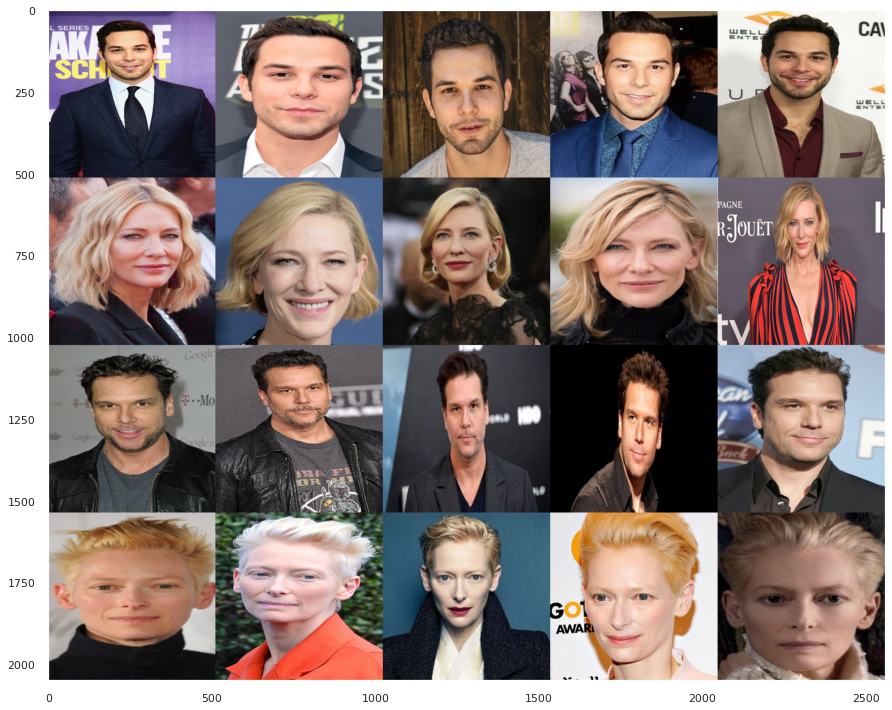

In [0]:
image_list = ['Astin_'+str(i+1)+'.jpg' for i in range(30)]+['Cate_'+str(i+1)+'.jpg' for i in range(30)]+['Cook_'+str(i+1)+'.jpg' for i in range(10)]+['Tilda_'+str(i+1)+'.jpg' for i in range(10)] #Name of the images

images = []
for i in range(80):
    image = cv2.imread(base_path+image_list[i])
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB) #By default imread reads the images in BGR space, so convert it into RGB
    image = cv2.resize(image,(512,512)) #Resize the images in order to plot it well. This will cause some images to be stretched
    images.append(image)

personA = np.hstack((images[0],images[1],images[2],images[3],images[4]))
personB = np.hstack((images[30],images[31],images[32],images[33],images[34]))
personC = np.hstack((images[60],images[61],images[62],images[63],images[64]))
personD = np.hstack((images[70],images[71],images[72],images[73],images[74]))

all_images = np.vstack((personA,personB,personC,personD))
plt.figure(figsize=(15,20))
plt.imshow(all_images)

Here we extract faces out using haarcascade_frontalface_default.xml

In [0]:
trained_haarcascade_url = "https://raw.githubusercontent.com/opencv/opencv/master/data/haarcascades/haarcascade_frontalface_default.xml"

with request.urlopen(trained_haarcascade_url) as r, open(os.path.join(base_path, "haarcascade_frontalface_default.xml"), 'wb') as f:
    f.write(r.read())

In [0]:
face_size = 100 #Faces will be resized 100 x 100 pixels
NUM_EIGEN_FACES = 20 # Number of EigenFaces

face_list = ['Astin_Face_'+str(i+1)+'.jpg' for i in range(30)]+['Cate_Face_'+str(i+1)+'.jpg' for i in range(30)]+['Cook_Face_'+str(i+1)+'.jpg' for i in range(10)]+['Tilda_Face_'+str(i+1)+'.jpg' for i in range(10)] #Face names

# Create the haar cascade
faceCascade = cv2.CascadeClassifier(os.path.join(base_path, "haarcascade_frontalface_default.xml"))

facePath = '/content/data/FaceData/ProcessedData/'

for i in range(80):
    # Read the image
    image = cv2.imread('/content/data/FaceData/'+image_list[i])
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY) #Convert the images to grayscale

    # Detect faces in the image

    faces = faceCascade.detectMultiScale(
        gray,
        scaleFactor=1.2,
        minNeighbors=5,
        minSize=(30, 30),
        flags=cv2.CASCADE_SCALE_IMAGE
    )

    for (x, y, w, h) in faces:
        crop_face = gray[y:y+h, x:x+w]
        crop_face = cv2.resize(crop_face, (face_size, face_size))
        image_name = face_list[i]
        cv2.imwrite(os.path.join(facePath, image_name), crop_face)

Those extracted faces were saved into `/content/data/FaceData/ProcessedData/`. We now display them below

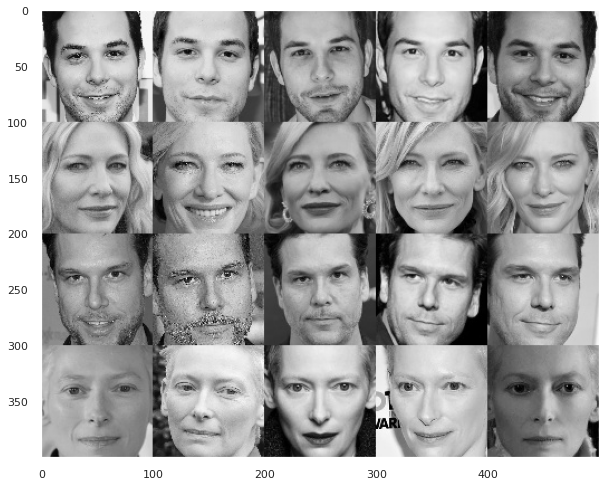

In [0]:
face_list = ['Astin_Face_'+str(i+1)+'.jpg' for i in range(30)]+['Cate_Face_'+str(i+1)+'.jpg' for i in range(30)]+['Cook_Face_'+str(i+1)+'.jpg' for i in range(10)]+['Tilda_Face_'+str(i+1)+'.jpg' for i in range(10)] #Face names

faces = []
for i in range(80):
    face = cv2.imread(facePath+face_list[i])
    faces.append(face)

personAface = np.hstack((faces[0],faces[1],faces[2],faces[3],faces[4]))
personBface = np.hstack((faces[30],faces[31],faces[32],faces[33],faces[34]))
personCface = np.hstack((faces[60],faces[61],faces[62],faces[63],faces[64]))
personDface = np.hstack((faces[70],faces[71],faces[72],faces[73],faces[74]))

all_faces = np.vstack((personAface,personBface,personCface,personDface))
plt.figure(figsize=(10,12))
plt.imshow(all_faces)

Now it is time to get the face data needed for classification. 


*   For training data, first 20 images of both Skylar (A) and Cate (B) were considered.
*   For testing data, last 10 images of both Skylar (A) and Cate (B) were considered. 
*   At the same time, we make a complete testing dataset with above Skylar (A) and Cate (B) but adding Dane (C) and Tilda (D) together.


 




In [0]:
face_list_names = ['Astin_Face_'+str(i+1)+'.jpg' for i in range(30)]+['Cate_Face_'+str(i+1)+'.jpg' for i in range(30)]+['Cook_Face_'+str(i+1)+'.jpg' for i in range(10)]+['Tilda_Face_'+str(i+1)+'.jpg' for i in range(10)] #Face names
face_list = list()

for i in range(80):
    processed_face = Image.open(facePath+face_list_names[i])
    processed_face = np.array(processed_face.getdata())
    face_list.append(processed_face)

X = np.array(face_list)
X_train = np.concatenate((X[:20], X[30:50]), axis=0) #A,B
X_test_all = np.concatenate((X[20:30], X[50:60], X[60:70], X[70:80]), axis=0) #A(0),B(1),C,D
X_test = np.concatenate((X[20:30], X[50:60]), axis=0) #A(0),B(1)

y_train = np.array([0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1], dtype='int64') #A(0),B(1)
y_test = np.array([0,0,0,0,0,0,0,0,0,0,1,1,1,1,1,1,1,1,1,1], dtype='int64') #A(0),B(1)
y_test_all = np.array([0,0,0,0,0,0,0,0,0,0,1,1,1,1,1,1,1,1,1,1,0,0,0,0,0,0,0,0,0,0,1,1,1,1,1,1,1,1,1,1], dtype='int64') #A(0),B(1),C(0),D(1)
target_names = np.array(['Skylar Astin', 'Cate Blanchett'], dtype='<U17')

n_classes = 2
w = 100
h = 100

##4 Feature Representation

---



###4.1 Handcrafted Features

#### **What is a Feature Descriptor**
A way of representing and simplifying image by extracting only useful information and discarding extra information from the image is known as 'feature vectors'


**What does HOG mean?**



**Histogram**:
The data is organized in bins.

**Oriented**:
The orientation of each pixel of the object being scanned.

**Gradients**:
The intensity change or gradient in the pixels of the object being scanned.

**Feature**:
Certain characteristics in the object that make it unique.

**Descriptor**:
This a feature vector computed using above attributes describing the information regarding the object’s features. Two descriptors can be compared to check if they are similar.

#### **HOG Procedure**

The Histogram of Oriented Gradients is a straightforward feature extraction procedure that was developed in the context of identifying pedestrians within images.
HOG involves the following steps:

1. Optionally pre-normalize images (resizing or color normalisation). This leads to features that resist dependence on variations in illumination [7].
2. Compute the gradient vector of every pixel, as well as its magnitude and direction.
3. Subdivide the image into cells of a predetermined size, and compute a histogram of the gradient orientations within each cell [6].
4. Normalize the histograms in each cell by comparing to the block of neighboring cells. This further suppresses the effect of illumination across the image.
5. Construct a one-dimensional feature vector from the information in each cell.

Typically, a feature descriptor [6] converts an image of size width x height x 3 (channels ) to a feature vector / array of length n. In this case of the HOG feature descriptor, the input image is of size 200 x 100 x 3 and the output feature vector is of length 3780.

A fast HOG extractor is built into the Scikit-Image project, and we can try it out relatively quickly and visualize the oriented gradients within each cell:

 Step 1) Read the image




(100, 100, 3)


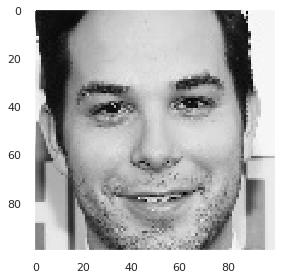

In [0]:
plt.rcParams["axes.grid"] = False
img = faces[0]
imshow(img)
print(img.shape)

Step 2) Resize image


(200, 100, 3)


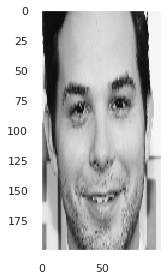

In [0]:
#Resizing image 
resized_img = resize(img, (200,100)) 
imshow(resized_img) 
print(resized_img.shape)

Step 3) Calculate the HOG of the gray scaled image with initial parameters.



In [0]:
# define parameters of HOG feature extraction
orientations = 9
pixels_per_cell = (8, 8)
cells_per_block = (2, 2)
default_params = {'orientations': 9,
    'pixels_per_cell': (8, 8),
    'cells_per_block': (2, 2),
    'transform_sqrt': True,
    'block_norm': "L2"}

#creating hog features 
def create_hog_features(img, params=default_params):
  orientations = params['orientations']
  pixels_per_cell = params['pixels_per_cell']
  cells_per_block = params['cells_per_block']
  transform_sqrt = params['transform_sqrt']
  block_norm = params['block_norm']
  # load the image, convert it to grayscale, and detect edges
  gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY) 
  edged = imutils.auto_canny(gray)
  resized_img = resize(img, (200,100)) 

  #creating hog features 
  fd, hog_image = hog(resized_img, orientations=orientations, pixels_per_cell=pixels_per_cell, cells_per_block=cells_per_block, block_norm=block_norm, feature_vector=True, visualize=True, transform_sqrt=transform_sqrt)# fd= feature descriptor
  return fd, hog_image, resized_img

def create_hog_features_for_images(img_faces, params=default_params):
    hog_faces = []
    resized_faces = []
    features = []
    for i in range(len(img_faces)):
        img = img_faces[i]
        #extracting hog features 
        fd, hog_image, resized_img = create_hog_features(img, params)

        # Rescale histogram for better display 
        hog_image_rescaled = exposure.rescale_intensity(hog_image, in_range=(0, 10)) 
        hog_faces.append(hog_image)
        resized_faces.append(resized_img)
        features.append(fd)
    return hog_faces, resized_faces, features



Now we create HOG features for different parameters. Then choose the one which is more descriptive. In this case the first HOG image has most visible features in the image i.e., 9504 features.

This feature descriptor technique is very different from the grabbing object technique used in the previous assignment. To grab an object a preprocessing technique was used such as gaussian smoothing and bilateral filtering, and then the color thresholding was used to filter out the object from the scene. Whereas, for HOG features, we first extracted the Region of Interest using face cascades and then converted the facial images to gray scale to generate the HOG feature vectors.

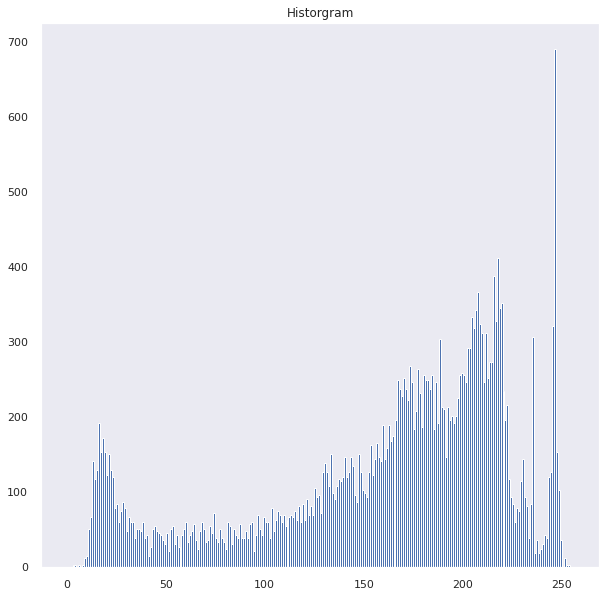

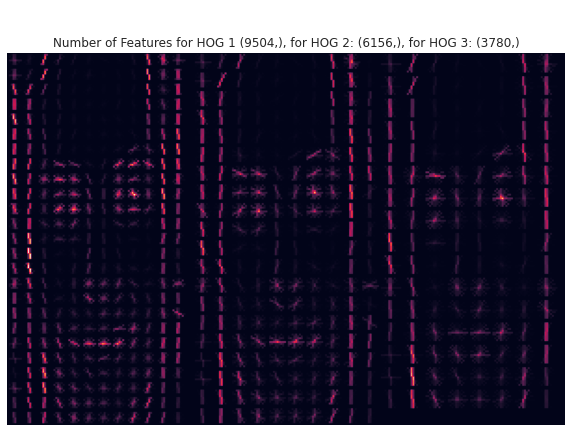

In [0]:
plt.figure(figsize=(10,10))
plt.hist(faces[0].ravel(),256,[0,256]);
plt.title("Historgram")
plt.show()

plt.rcParams["axes.grid"] = False

s1, hog_face1, _ = create_hog_features(faces[0])
# Rescale histogram for better display 
hog_image_rescaled1 = exposure.rescale_intensity(hog_face1, in_range=(0, 10)) 

params2 = {'orientations': 9, 'pixels_per_cell': (10, 10), 'cells_per_block': (2, 2), 'transform_sqrt':True, 'block_norm':'L2'}
s2, hog_face2, resized_img = create_hog_features(faces[0], params2)
# Rescale histogram for better display 
hog_image_rescaled2 = exposure.rescale_intensity(hog_face2, in_range=(0, 10)) 

params3 = {'orientations': 9, 'pixels_per_cell': (12, 12), 'cells_per_block': (2, 2),'transform_sqrt':True, 'block_norm':'L2'}
s3, hog_face3, _ = create_hog_features(faces[0], params3)
# Rescale histogram for better display 
hog_image_rescaled3 = exposure.rescale_intensity(hog_face3, in_range=(0, 10)) 

h2 = np.hstack((hog_image_rescaled1, hog_image_rescaled2, hog_image_rescaled3))
plt.figure(figsize=(10,12))
plt.title("\n\nNumber of Features for HOG 1 {}, for HOG 2: {}, for HOG 3: {}".format(s1.shape, s2.shape, s3.shape))
plt.axis('off')
plt.imshow(h2)


Next we compute HOG features for all the face dataset. Notice the last row has HOG vectors for the full image of the person but since our main focus is to only detect and distinguish among the faces, we extract and process only the features of faces.

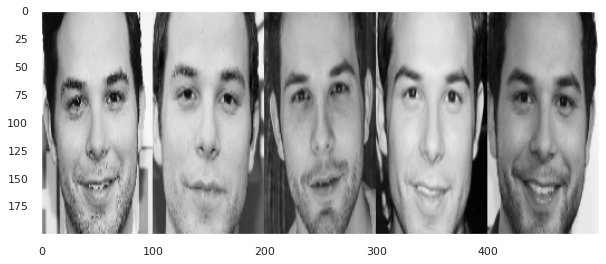

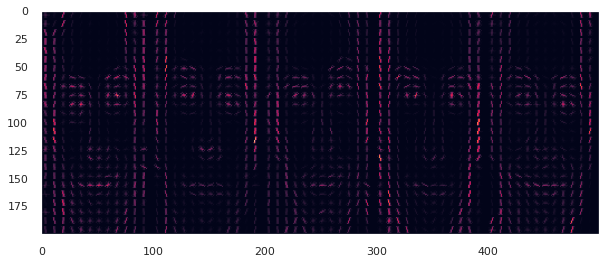

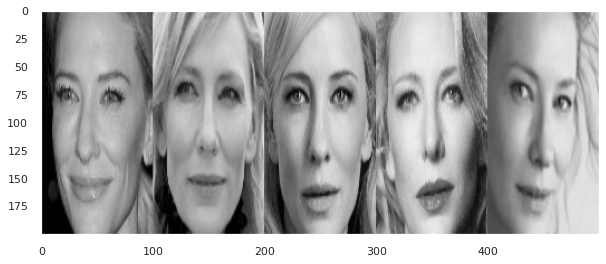

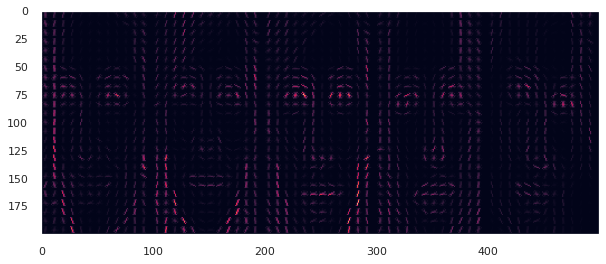

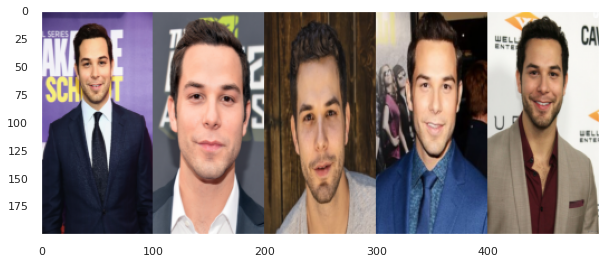

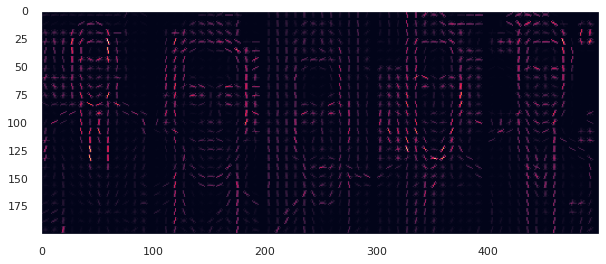

In [0]:
hog_faces, resized_faces, _ = create_hog_features_for_images(faces[:20]+faces[31:50])

h1 = np.hstack((resized_faces[0],resized_faces[1],resized_faces[2],resized_faces[3],resized_faces[4]))
plt.figure(figsize=(10,12))
plt.imshow(h1)

h2 = np.hstack((hog_faces[0],hog_faces[1],hog_faces[2],hog_faces[3],hog_faces[4]))
plt.figure(figsize=(10,12))
plt.imshow(h2)

h1 = np.hstack((resized_faces[31],resized_faces[32],resized_faces[33],resized_faces[34],resized_faces[35]))
plt.figure(figsize=(10,12))
plt.imshow(h1)

h2 = np.hstack((hog_faces[31],hog_faces[32],hog_faces[33],hog_faces[34],hog_faces[35]))
plt.figure(figsize=(10,12))
plt.imshow(h2)

hog_faces2, resized_faces, _ = create_hog_features_for_images(images[:10])

h1 = np.hstack((resized_faces[0],resized_faces[1],resized_faces[2],resized_faces[3],resized_faces[4]))
plt.figure(figsize=(10,12))
plt.imshow(h1)

h2 = np.hstack((hog_faces2[0],hog_faces2[1],hog_faces2[2],hog_faces2[3],hog_faces2[4]))
plt.figure(figsize=(10,12))
plt.imshow(h2)



Next we train the model using KNeighborsClassifier and calculate the Euclidean distances between feature outputs of the training images and test images and classify the test images of person A and B provided. The training dataset has HOG features for 40 facial images of person A and B and the test images have HOG features for 20 facial images of person A and B.

In [0]:
# initialize the data matrix and labels
training_images = faces[:20] + faces[30:50]

def train_images(params, training_images=training_images, training_labels=y_train):
	data = []
	labels = []
	# prepare_training_images
	# loop over the image paths in the training set
	print("Training {} images".format(len(training_images)))
	for  (i, image) in enumerate(training_images):
		# extract the celebrity from face
		celebrity = "Cate Blanchett"
		if (training_labels[i] == 0):
			celebrity = "Skylar Astin"
		print("[INFO] extracting features... for image {}".format(face_list_names[i]))
		# extract Histogram of Oriented Gradients from the face
		H, hog_face, _ = create_hog_features(image, params)
		
		# update the data and labels
		data.append(H)
		labels.append(celebrity)
	print("Training Succeeded")
	return data, labels

test_set = faces[20:30]+faces[50:60]
def test_images(params, test_images=test_set, test_labels=y_test):
	resulted_imgs = []
	predictions = []
	data = []
	labels = []
	print("Testing {} images".format(len(test_images)))
	for (i, image) in enumerate(test_images):
		celebrity = "Cate Blanchett"
		if (test_labels[i] == 0):
			celebrity = "Skylar Astin"
		print("[INFO] extracting features... for image {}".format(face_list_names[i]))
		# extract Histogram of Oriented Gradients from the face
		H, hog_face, _ = create_hog_features(image, params)
	
		# extract Histogram of Oriented Gradients from the test image and
		# predict the name of the celebrity
		pred = model.predict(H.reshape(1, -1))[0]
		data.append(H)
		labels.append(celebrity)
		# visualize the HOG image
		# draw the prediction on the test image and display it
		img = image.copy()
		cv2.putText(img, pred.title(), (10, 35), cv2.FONT_HERSHEY_SIMPLEX, 1.0, (0, 255, 0), 3)
		predictions.append(pred.title())
		resulted_imgs.append(img)
	print("Testing Succeeded")
	return data, labels, resulted_imgs, predictions

params = {'orientations': 9, 'pixels_per_cell': (10, 10), 'cells_per_block': (2, 2), 'transform_sqrt':True, 'block_norm':'L2'}
data, labels = train_images(params)

Training 40 images
[INFO] extracting features... for image Astin_Face_1.jpg
[INFO] extracting features... for image Astin_Face_2.jpg
[INFO] extracting features... for image Astin_Face_3.jpg
[INFO] extracting features... for image Astin_Face_4.jpg
[INFO] extracting features... for image Astin_Face_5.jpg
[INFO] extracting features... for image Astin_Face_6.jpg
[INFO] extracting features... for image Astin_Face_7.jpg
[INFO] extracting features... for image Astin_Face_8.jpg
[INFO] extracting features... for image Astin_Face_9.jpg
[INFO] extracting features... for image Astin_Face_10.jpg
[INFO] extracting features... for image Astin_Face_11.jpg
[INFO] extracting features... for image Astin_Face_12.jpg
[INFO] extracting features... for image Astin_Face_13.jpg
[INFO] extracting features... for image Astin_Face_14.jpg
[INFO] extracting features... for image Astin_Face_15.jpg
[INFO] extracting features... for image Astin_Face_16.jpg
[INFO] extracting features... for image Astin_Face_17.jpg
[INF

In [0]:
# "train" the nearest neighbors classifier
print("[INFO] training classifier...")
model = KNeighborsClassifier(n_neighbors=1)
model.fit(data, labels)
print('Train Score: ', model.score(data, labels))
print("[INFO] evaluating labels of training data...")
print(labels)

[INFO] training classifier...
Train Score:  1.0
[INFO] evaluating labels of training data...
['Skylar Astin', 'Skylar Astin', 'Skylar Astin', 'Skylar Astin', 'Skylar Astin', 'Skylar Astin', 'Skylar Astin', 'Skylar Astin', 'Skylar Astin', 'Skylar Astin', 'Skylar Astin', 'Skylar Astin', 'Skylar Astin', 'Skylar Astin', 'Skylar Astin', 'Skylar Astin', 'Skylar Astin', 'Skylar Astin', 'Skylar Astin', 'Skylar Astin', 'Cate Blanchett', 'Cate Blanchett', 'Cate Blanchett', 'Cate Blanchett', 'Cate Blanchett', 'Cate Blanchett', 'Cate Blanchett', 'Cate Blanchett', 'Cate Blanchett', 'Cate Blanchett', 'Cate Blanchett', 'Cate Blanchett', 'Cate Blanchett', 'Cate Blanchett', 'Cate Blanchett', 'Cate Blanchett', 'Cate Blanchett', 'Cate Blanchett', 'Cate Blanchett', 'Cate Blanchett']


Testing 20 images
[INFO] extracting features... for image Astin_Face_1.jpg
[INFO] extracting features... for image Astin_Face_2.jpg
[INFO] extracting features... for image Astin_Face_3.jpg
[INFO] extracting features... for image Astin_Face_4.jpg
[INFO] extracting features... for image Astin_Face_5.jpg
[INFO] extracting features... for image Astin_Face_6.jpg
[INFO] extracting features... for image Astin_Face_7.jpg
[INFO] extracting features... for image Astin_Face_8.jpg
[INFO] extracting features... for image Astin_Face_9.jpg
[INFO] extracting features... for image Astin_Face_10.jpg
[INFO] extracting features... for image Astin_Face_11.jpg
[INFO] extracting features... for image Astin_Face_12.jpg
[INFO] extracting features... for image Astin_Face_13.jpg
[INFO] extracting features... for image Astin_Face_14.jpg
[INFO] extracting features... for image Astin_Face_15.jpg
[INFO] extracting features... for image Astin_Face_16.jpg
[INFO] extracting features... for image Astin_Face_17.jpg
[INFO

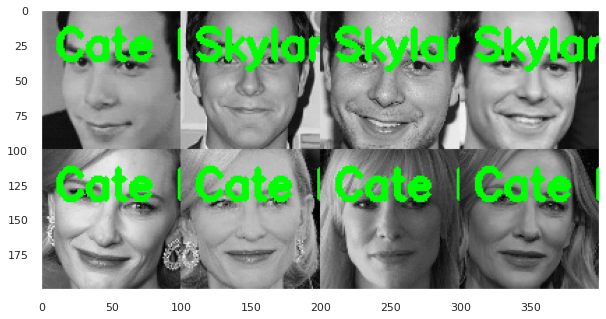

In [0]:
#TEST DATA
params = {'orientations': 9, 'pixels_per_cell': (10, 10), 'cells_per_block': (2, 2), 'transform_sqrt':True, 'block_norm':'L2'}
test_data, test_labels, resulted_imgs, predictions = test_images(params)

personAface = np.hstack((resulted_imgs[6], resulted_imgs[7], resulted_imgs[8], resulted_imgs[9]))
personBface = np.hstack((resulted_imgs[10],resulted_imgs[11],resulted_imgs[12],resulted_imgs[13]))
all_faces = np.vstack((personAface,personBface))

plt.figure(figsize=(10,12))
plt.imshow(all_faces)

print('Test Score: ', model.score(test_data, test_labels))
print('\nPredicted Labels: ', predictions)


As we can see from above, the classification was not perfect and generated some errors (E.g., Skylar was mispredicted as Cate in the first image). This model has an accuracy of 0.95.
Next we see if HOG is invariant to rotation of images.

Testing 1 images
[INFO] extracting features... for image Astin_Face_1.jpg
Testing Succeeded


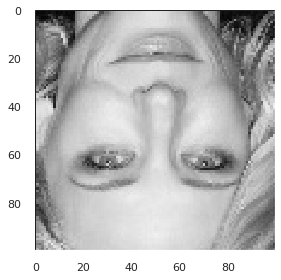

In [0]:
rotated = imutils.rotate(faces[38], 180)
imshow(rotated)
test_data, test_labels, resulted_imgs, predictions = test_images(params, [rotated], [1])

Testing 1 images
[INFO] extracting features... for image Astin_Face_1.jpg
Testing Succeeded


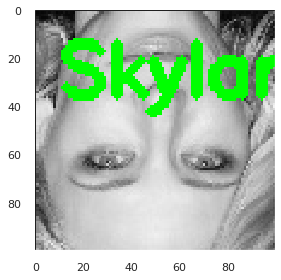

In [0]:
test_data, test_labels, resulted_imgs, predictions = test_images(params, [rotated], [1])
imshow(resulted_imgs[0])

Therefore, we see that HOG is not invariant to rotation. However, we can improve the classification accuracy by doing some HOG parameter tuning.
This will be done by performing a  Grid Search on different HOG parameters using sklearn's Grid Search method.

In [0]:
#Some Helper methods and classes for the HOG pipeline to be used in Grid Search
class RGB2GrayTransformer(BaseEstimator, TransformerMixin):
    """
    Convert an array of RGB images to grayscale
    """
 
    def __init__(self):
        pass
 
    def fit(self, X, y=None):
        """returns itself"""
        return self
 
    def transform(self, X, y=None):
        """perform the transformation and return an array"""
        return np.array([rgb2gray(img) for img in X])
 
 
class HogTransformer(BaseEstimator, TransformerMixin):
    """
    Expects an array of 2d arrays (1 channel images)
    Calculates hog features for each img
    """
 
    def __init__(self, y=None, orientations=9,
                 pixels_per_cell=(8, 8),
                 cells_per_block=(3, 3), block_norm='L2-Hys', transform_sqrt=True):
        self.y = y
        self.orientations = orientations
        self.pixels_per_cell = pixels_per_cell
        self.cells_per_block = cells_per_block
        self.block_norm = block_norm
        self.transform_sqrt = transform_sqrt
 
    def fit(self, X, y=None):
        return self
 
    def transform(self, X, y=None):
 
        def local_hog(X):
            return hog(X,
                       orientations=self.orientations,
                       pixels_per_cell=self.pixels_per_cell,
                       cells_per_block=self.cells_per_block,
                       block_norm=self.block_norm, transform_sqrt=self.transform_sqrt)
 
        try: # parallel
            return np.array([local_hog(img) for img in X])
        except:
            return np.array([local_hog(img) for img in X])


In [0]:
#Defining the HOG pipeline
HOG_pipeline = Pipeline([
    ('grayify', RGB2GrayTransformer()),
    ('hogify', HogTransformer(
        pixels_per_cell=(8, 8),
        cells_per_block=(2,2),
        orientations=9,
        block_norm='L2-Hys',
        transform_sqrt= True)
    ),
    ('scalify', StandardScaler()),
    ('classify', KNeighborsClassifier(n_neighbors=1))
])

param_grid = [
    {'hogify__orientations': [9],
    'hogify__cells_per_block': [(2, 2), (3, 3)],
    'hogify__pixels_per_cell': [(8, 8), (14, 14)],
    'hogify__block_norm': ['L1','L2','L2-Hys', 'L1-sqrt'],
    'hogify__transform_sqrt': [True, False]},
]
grid_search = GridSearchCV(HOG_pipeline, param_grid, cv=3, n_jobs=-1, scoring='accuracy',verbose=1, return_train_score=True)
print(len(training_images))
print(len(labels))
grid_res = grid_search.fit(training_images, labels)
# description of the best performing object, a pipeline in our case.

print(grid_res.best_estimator_)
print('Train Score: ', model.score(data, labels))

40
40
Fitting 3 folds for each of 32 candidates, totalling 96 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done  46 tasks      | elapsed:    7.4s


Pipeline(memory=None,
         steps=[('grayify', RGB2GrayTransformer()),
                ('hogify',
                 HogTransformer(block_norm='L2-Hys', cells_per_block=(2, 2),
                                orientations=9, pixels_per_cell=(14, 14),
                                transform_sqrt=True, y=None)),
                ('scalify',
                 StandardScaler(copy=True, with_mean=True, with_std=True)),
                ('classify',
                 KNeighborsClassifier(algorithm='auto', leaf_size=30,
                                      metric='minkowski', metric_params=None,
                                      n_jobs=None, n_neighbors=1, p=2,
                                      weights='uniform'))],
         verbose=False)
Train Score:  1.0


[Parallel(n_jobs=-1)]: Done  96 out of  96 | elapsed:   16.2s finished


The best results are found for these parameters.

In [0]:
# the highscore during the search
print(grid_res.best_score_)
pp = pprint.PrettyPrinter(width=41, compact=True)
pp.pprint(grid_res.best_params_)

0.9505494505494506
{'hogify__block_norm': 'L2-Hys',
 'hogify__cells_per_block': (2, 2),
 'hogify__orientations': 9,
 'hogify__pixels_per_cell': (14, 14),
 'hogify__transform_sqrt': True}


The model is then retrained using these parameters and the accuracy is checked against the test data.

Training 40 images
[INFO] extracting features... for image Astin_Face_1.jpg
[INFO] extracting features... for image Astin_Face_2.jpg
[INFO] extracting features... for image Astin_Face_3.jpg
[INFO] extracting features... for image Astin_Face_4.jpg
[INFO] extracting features... for image Astin_Face_5.jpg
[INFO] extracting features... for image Astin_Face_6.jpg
[INFO] extracting features... for image Astin_Face_7.jpg
[INFO] extracting features... for image Astin_Face_8.jpg
[INFO] extracting features... for image Astin_Face_9.jpg
[INFO] extracting features... for image Astin_Face_10.jpg
[INFO] extracting features... for image Astin_Face_11.jpg
[INFO] extracting features... for image Astin_Face_12.jpg
[INFO] extracting features... for image Astin_Face_13.jpg
[INFO] extracting features... for image Astin_Face_14.jpg
[INFO] extracting features... for image Astin_Face_15.jpg
[INFO] extracting features... for image Astin_Face_16.jpg
[INFO] extracting features... for image Astin_Face_17.jpg
[INF

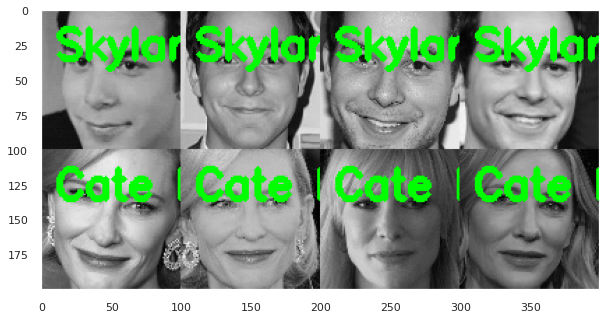

In [0]:
params = {'orientations': 9, 'pixels_per_cell': (14, 14), 'cells_per_block': (2, 2), 'transform_sqrt':True, 'block_norm':'L2-Hys'}
#Train Data
training_data, training_labels = train_images(params)

model = KNeighborsClassifier(n_neighbors=1)
model.fit(training_data, training_labels)
print('Train Score: ', model.score(training_data, training_labels))
print("\n")

#Test DATA
test_data, test_labels, resulted_imgs, predictions = test_images(params)
personAface = np.hstack((resulted_imgs[6], resulted_imgs[7], resulted_imgs[8], resulted_imgs[9]))
personBface = np.hstack((resulted_imgs[10],resulted_imgs[11],resulted_imgs[12],resulted_imgs[13]))
all_faces = np.vstack((personAface,personBface))

plt.figure(figsize=(10,12))
plt.imshow(all_faces)

print('Test Score: ', model.score(test_data, test_labels))
print('\nPredicted Labels: ', predictions)
print(test_data[0].shape)

Next we check if the new parameters have improved the rotation invariance for HOG.

Testing 1 images
[INFO] extracting features... for image Astin_Face_1.jpg
Testing Succeeded


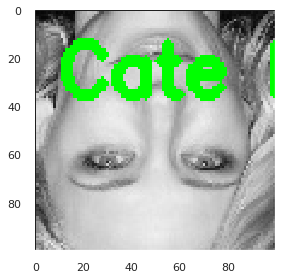

In [0]:
test_data, test_labels, resulted_imgs, predictions = test_images(params, [rotated], [1])
imshow(resulted_imgs[0])

###4.2.1 Unsupervised learning: PCA

Each image in this training set is 100 x 100 and grayscale. We need to learn a typical (i.e. Eigen) face from them. There are 40 images in this dataset. A few of them are shown below.

(40, 10000)


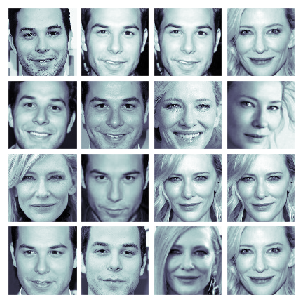

In [0]:
print(X_train.shape) # there are 40 faces each of them is of 100x100=10000 pixels
fig = plt.figure(figsize=(4,4)) 
fig.subplots_adjust(left=0, right=1, bottom=0, top=1, hspace=0.05, wspace=0.05) 
# plot 16 random faces
j = 1
np.random.seed(0)
for i in np.random.choice(range(X_train.shape[0]), 16): 
    ax = fig.add_subplot(4, 4, j, xticks=[], yticks=[]) 
    ax.imshow(np.reshape(X_train[i,:],(100,100)), cmap=plt.cm.bone, interpolation='nearest') 
    j += 1
plt.show()

**Reduce feature length with PCA**

PCA (short for Principal Component Analysis) [1] is a statistical procedure that questions if features representing the data are equally important. Are some of the features redundant enough that we can get similar results on say classification even after removing those features? 

PCA is considered one of the go-to techniques for dimensionality reduction. Note that it does not eliminate redundant features, instead it generates a new set of features that are a linear combination of the input features. These linear features are orthogonal to each other, which is why all the redundant features are absent. These features are known as principal components.

Performing PCA is pretty simple, using the scikit-learn library.

The next sections will be focused on choosing an optimal number ***p*** of principal component that the dimensionality of the feature space is reduced but still informative. First, we build a helper function that calculates accuracy using the nearest neighbours brute force algorithm to check the accuracy under different values of ***p***.





In [0]:
# Helper function that calculates accuracy using the nearest neighbors brute force algorithm
def calculate_accuracy(X_train):
    num_nearest_neighbors = 5
    correct_prediction = 0
    incorrect_prediction = 0
    neighbors = NearestNeighbors(n_neighbors=num_nearest_neighbors, algorithm='brute', metric='euclidean').fit(X_train, y_train)
    start = time.time()
    for i in range(len(x_test)):
        distances, indices = neighbors.kneighbors([x_test[i]])
        for j in range(1, num_nearest_neighbors):
          if ((y_test[i] == y_train[indices[0][j]]).all()):
            correct_prediction += 1
          else:
            incorrect_prediction += 1
    end = time.time()
    accuracy = round(100.0 * correct_prediction / (1.0 * correct_prediction + incorrect_prediction), 2), end - start
    return accuracy

In [0]:
x_test = X_test
print("Accuracy on original feature set : ", calculate_accuracy(X_train))

Accuracy on original feature set :  (75.0, 0.0726933479309082)


Here we got the accuracy on the original feature set, around 75%, which is not too bad but spaces for improvement!

Now we test accuracy under different values of ***p*** in PCA and see which achieves the best solution:

In [0]:
pca_dimensions = [1,2,3,4,5,6,7,8,9,10]
pca_accuracy = []
pca_time = []

for dimensions in pca_dimensions:
    pca = PCA(n_components=dimensions)
    pca.fit(X_train)
    feature_list_compressed = pca.transform(X_train)
    x_test = pca.transform(X_test)
    # Calculate accuracy over the compressed features
    accuracy, t = calculate_accuracy(feature_list_compressed)
    pca_time.append(t)
    pca_accuracy.append(accuracy)
    print("For PCA Dimensions = ", dimensions, ",\tAccuracy = ", accuracy, "%", ",\tTime = ", pca_time[-1])

For PCA Dimensions =  1 ,	Accuracy =  52.5 % ,	Time =  0.00954747200012207
For PCA Dimensions =  2 ,	Accuracy =  63.75 % ,	Time =  0.008295536041259766
For PCA Dimensions =  3 ,	Accuracy =  67.5 % ,	Time =  0.008684873580932617
For PCA Dimensions =  4 ,	Accuracy =  75.0 % ,	Time =  0.011800050735473633
For PCA Dimensions =  5 ,	Accuracy =  75.0 % ,	Time =  0.009166717529296875
For PCA Dimensions =  6 ,	Accuracy =  75.0 % ,	Time =  0.00842905044555664
For PCA Dimensions =  7 ,	Accuracy =  76.25 % ,	Time =  0.008838176727294922
For PCA Dimensions =  8 ,	Accuracy =  78.75 % ,	Time =  0.008486270904541016
For PCA Dimensions =  9 ,	Accuracy =  76.25 % ,	Time =  0.008554935455322266
For PCA Dimensions =  10 ,	Accuracy =  80.0 % ,	Time =  0.008523941040039062


Let's plot the test time accuracy for each PCA dimension.

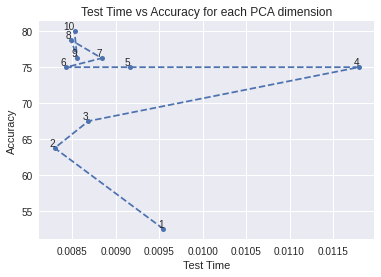

In [0]:
f = plt.figure()

plt.style.use('seaborn')
plt.plot(pca_time, pca_accuracy, 'o--', markersize=5)
for label, x, y in zip(pca_dimensions, pca_time, pca_accuracy):
    plt.annotate(label, xy=(x, y), ha='right', va='bottom')
plt.title('Test Time vs Accuracy for each PCA dimension')
plt.xlabel('Test Time')
plt.ylabel('Accuracy')
plt.grid(True)
plt.show()

PCA dimension = 10 achieved the best accuracy and really good time as well! So we decide to use ***p***=10 for the next stages.

But how about variance? Here we also provide plots for Variance and Cumulative Variance vs number of PCA dimensions. 

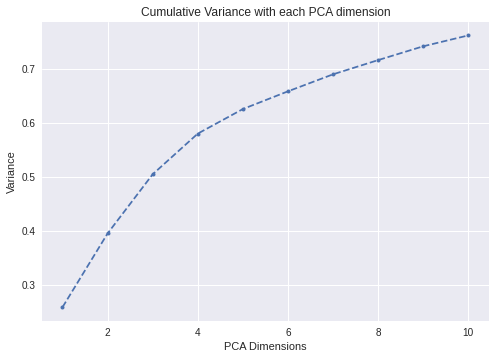

In [0]:
plt.plot(range(1,11),pca.explained_variance_ratio_.cumsum(),'o--', markersize=4)
plt.title ('Cumulative Variance with each PCA dimension')
plt.xlabel('PCA Dimensions')
plt.ylabel('Variance')
plt.grid(True)
plt.show()

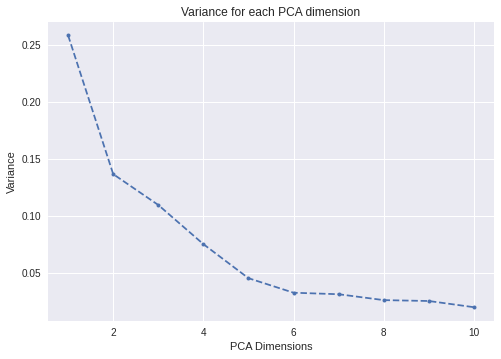

In [0]:
pca = PCA(10)
pca.fit(X_train)
plt.style.use('seaborn')
plt.plot(range(1,11),pca.explained_variance_ratio_,'o--', markersize=4)
plt.title ('Variance for each PCA dimension')
plt.xlabel('PCA Dimensions')
plt.ylabel('Variance')
plt.grid(True)
plt.show()

#### **Computing the EigenFaces**

As described in the [original paper from MIT](http://www.mit.edu/~9.54/fall14/Classes/class10/Turk%20Pentland%20Eigenfaces.pdf) and this [case study from JHU](http://www.vision.jhu.edu/teaching/vision08/Handouts/case_study_pca1.pdf), the following figure shows the theory/algorithm for how to efficiently compute the eigenfaces from the (training) images and then choose top ***k*** eigenfaces (eigenvectors). [3]

The next 3 figures show the mean face, the SD face and the percentage variance captured by the eigenfaces.

(40, 10)


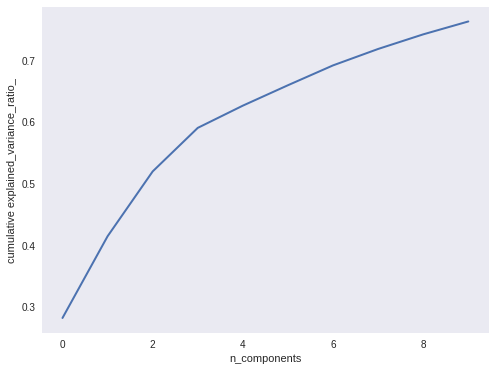

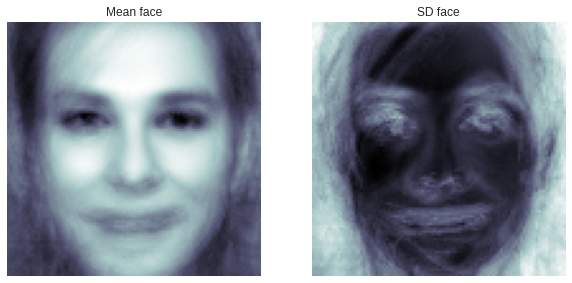

In [0]:
n_comp =10
pipeline = Pipeline([('scaling', StandardScaler()), ('pca', PCA(n_components=n_comp))])
faces_proj = pipeline.fit_transform(X_train)
print(faces_proj.shape)
mean_face = np.reshape(pipeline.named_steps['scaling'].mean_, (100,100))
sd_face = np.reshape(np.sqrt(pipeline.named_steps['scaling'].var_), (100,100))
plt.figure(figsize=(8, 6))
plt.plot(np.cumsum(pipeline.named_steps['pca'].explained_variance_ratio_), linewidth=2)
plt.grid(), plt.axis('tight'), plt.xlabel('n_components'), plt.ylabel('cumulative explained_variance_ratio_')
plt.show()
plt.figure(figsize=(10,5))
plt.subplot(121), plt.imshow(mean_face, cmap=plt.cm.bone), plt.axis('off'), plt.title('Mean face')
plt.subplot(122), plt.imshow(sd_face, cmap=plt.cm.bone), plt.axis('off'), plt.title('SD face')
plt.show()

 **Projection on the EigenFaces and Reconstruction**

Now, let’s project a face onto the face space to generate a vector of k coefficients, one for each of the k eigenfaces (for different values of k). Then let’s reconstruct the same face from the vector of coefficients computed.

We plot the first 10 eigenfaces below:

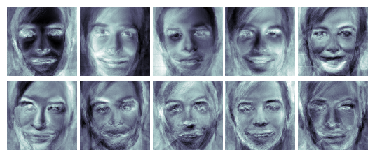

In [0]:
fig = plt.figure(figsize=(5,2)) 
fig.subplots_adjust(left=0, right=1, bottom=0, top=1, hspace=0.05, wspace=0.05) 
# plot the first 10 eigenfaces
for i in range(10): 
    ax = fig.add_subplot(2, 5, i+1, xticks=[], yticks=[]) 
    ax.imshow(np.reshape(pipeline.named_steps['pca'].components_[i,:], (100,100)), cmap=plt.cm.bone, interpolation='nearest')

Now we reconstruct the faces:

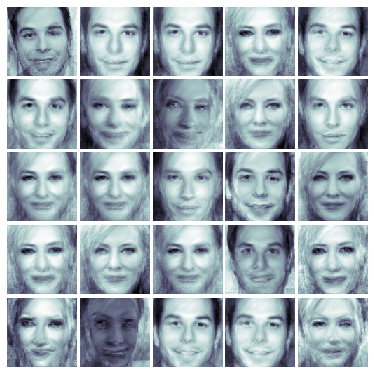

In [0]:
# face reconstruction
faces_inv_proj = pipeline.named_steps['pca'].inverse_transform(faces_proj) 
#reshaping as 40 images of 100x100 dimension 
fig = plt.figure(figsize=(5,5)) 
fig.subplots_adjust(left=0, right=1, bottom=0, top=1, hspace=0.05, wspace=0.05) 
# plot the faces, each image is 100 by 100 dimension but 10x10 pixels 
j = 1
np.random.seed(0)
for i in np.random.choice(range(X_train.shape[0]), 25): 
    ax = fig.add_subplot(5, 5, j, xticks=[], yticks=[]) 
    ax.imshow(mean_face + sd_face*np.reshape(faces_inv_proj,(40,100,100)) [i,:], cmap=plt.cm.bone, interpolation='nearest')
    j += 1

Here we can see how a face is reconstructed below (we picked face #6) [4] [5]:

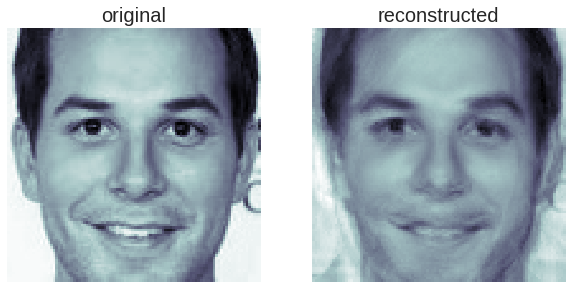

In [0]:
orig_face = np.reshape(X_train[5,:], (100,100))
reconst_face = np.reshape(faces_proj[5,:]@pipeline.named_steps['pca'].components_, (100,100))
reconst_face = mean_face + sd_face*reconst_face
plt.figure(figsize=(10,5))
plt.subplot(121), plt.imshow(orig_face, cmap=plt.cm.bone, interpolation='nearest'), plt.axis('off'), plt.title('original', size=20)
plt.subplot(122), plt.imshow(reconst_face, cmap=plt.cm.bone, interpolation='nearest'), plt.axis('off'), plt.title('reconstructed', size=20)
plt.show()

Now we use these learnt eigenfaces to project our training and testing images onto the same 10-components and visualise the faces on a face-feature plot of the first 2 principal components.

In [0]:
from time import time
n_components = 10

print("Extracting the top %d eigenfaces from %d faces"
      % (n_components, X_train.shape[0]))

t0 = time()
pca = PCA(n_components=n_components, svd_solver='randomized',
          whiten=True).fit(X_train)
print("This task was done in %0.3fs.\n" % (time() - t0))

eigenfaces = pca.components_.reshape((n_components, h, w))

print("Projecting the input data on the eigenfaces orthonormal basis")

t0 = time()
X_train_pca = pca.transform(X_train)
X_test_pca = pca.transform(X_test)
X_test_all_pca = pca.transform(X_test_all)
print("This task was done in %0.3fs." % (time() - t0))

Extracting the top 10 eigenfaces from 40 faces
This task was done in 0.033s.

Projecting the input data on the eigenfaces orthonormal basis
This task was done in 0.008s.


In [0]:
X_train.shape

(40, 10000)

In [0]:
X_train_pca.shape

(40, 10)

PCA reduced the dimensions of the images from 10000 to only 10!

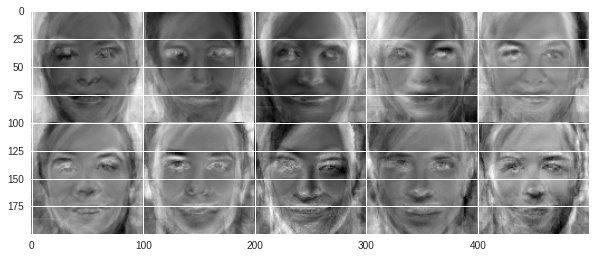

In [0]:
def process_eigenfaces(eigenfaces):
    process_eigenfaces = []
    for i in range(len(eigenfaces)):
        eigenFace = eigenfaces[i]
        eigenFace = ((eigenFace - eigenFace.min()) * (1/(eigenFace.max() - eigenFace.min()) * 255)).astype('uint8')
        eigenFace = cv2.cvtColor(eigenFace, cv2.COLOR_GRAY2RGB)
        process_eigenfaces.append(eigenFace)
    return process_eigenfaces

processed_efs = process_eigenfaces(eigenfaces)

h1 = np.hstack((processed_efs[0],processed_efs[1],processed_efs[2],processed_efs[3],processed_efs[4]))
h2 = np.hstack((processed_efs[5],processed_efs[6],processed_efs[7],processed_efs[8],processed_efs[9]))
efaces = np.vstack((h1,h2))
plt.figure(figsize=(10,12))
plt.imshow(efaces)

n_components_2d = 2
pca_2d = PCA(n_components=n_components_2d, svd_solver='randomized',
          whiten=True).fit(X_train)
X_train_pca_2d = pca_2d.transform(X_train)
X_test_pca_2d = pca_2d.transform(X_test)
X_test_all_pca_2d = pca_2d.transform(X_test_all)

def pca_2d_reshape(pca_2d):
    pca_2d_reshape = []
    for i in range(len(pca_2d)):
        pca_i = pca_2d[i]
        pca_i = (pca_i*1024).astype('int8')+256
        pca_2d_reshape.append(pca_i)
    return pca_2d_reshape

X_train_pca_2d_reshape = pca_2d_reshape(X_train_pca_2d)
X_test_pca_2d_reshape = pca_2d_reshape(X_test_pca_2d)
X_test_all_pca_2d_reshape = pca_2d_reshape(X_test_all_pca_2d)

Face Feature Plot Using PCA reduction on images to 2D - Training Data (AB)

Text(0, 0.5, 'PCA Component 2')

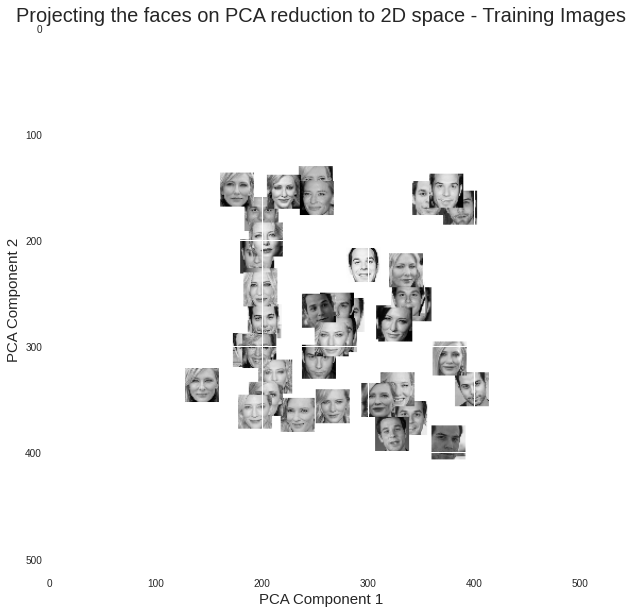

In [0]:
#Face Feature Plot Using PCA reduction on images to 2D - Train Data
img = np.zeros((512,512,3), dtype=np.uint8)
img.fill(255) 
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
train_faces = faces[0:20]+faces[30:50]
for i in range(40):
    train_f = train_faces[i]
    train_f = cv2.resize(train_f,(32,32)) #Faces will be bit blurred as we are resizing from (100,100) to (32,32)
    x = X_train_pca_2d_reshape[i][0]
    y = X_train_pca_2d_reshape[i][1]
    h = 32
    w = 32
    img[y:y+h, x:x+w] = train_f
    
plt.figure(figsize=(10,10))
plt.imshow(img)
plt.title('Projecting the faces on PCA reduction to 2D space - Training Images',fontsize=20)
plt.xlabel('PCA Component 1',fontsize=15)
plt.ylabel('PCA Component 2',fontsize=15)

Face Feature Plot Using PCA reduction on images to 2D - Testing Data (ABCD)

Text(0, 0.5, 'PCA Component 2')

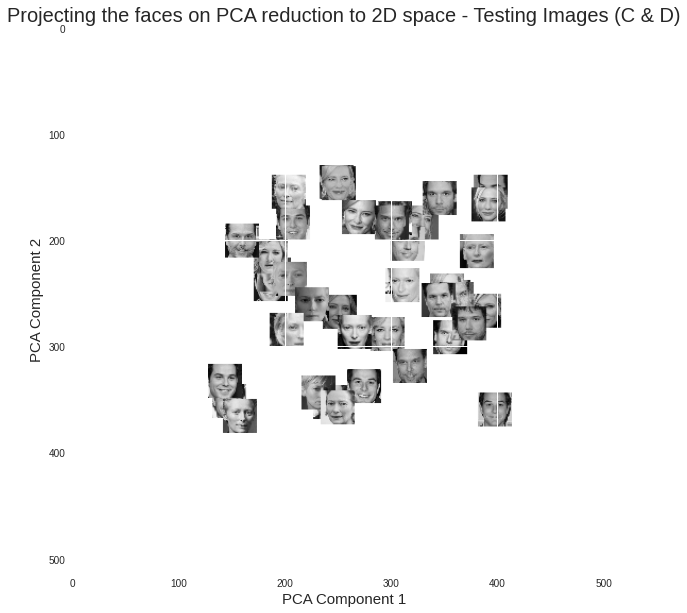

In [0]:
img = np.zeros((512,512,3), dtype=np.uint8)
img = img.astype('uint8')
img.fill(255) 
#test_faces_all = faces[60:70]+faces[70:80]
test_faces_all = faces[20:30]+faces[50:80]
for i in range(40):
    test_f = test_faces_all[i]
    test_f = cv2.resize(test_f,(32,32)) #Faces will be bit blurred as we are resizing from (100,100) to (32,32)
    x = X_test_all_pca_2d_reshape[i][0]
    y = X_test_all_pca_2d_reshape[i][1]
    h = 32
    w = 32
    img[y:y+h, x:x+w] = test_f
    
plt.figure(figsize=(10,10))
plt.imshow(img)
plt.title('Projecting the faces on PCA reduction to 2D space - Testing Images (C & D)',fontsize=20)
plt.xlabel('PCA Component 1',fontsize=15)
plt.ylabel('PCA Component 2',fontsize=15)

###4.2.2 Transfer learning

Transfer learning involves leveraging a network which has already been trained, reusing the learned weights for a different task. Here, we use the Oxford VGG's VGG-Face network, a CNN with 16 Layers trained on faces.

Preprocessing the files to get color face images

In [0]:
# code below copied from above, but changed to save color versions at 244 x 244 

face_size = 244 # dimensions changed for vgg
NUM_EIGEN_FACES = 20 # Number of EigenFaces

face_list = ['Astin_Face_'+str(i+1)+'.jpg' for i in range(30)]+['Cate_Face_'+str(i+1)+'.jpg' for i in range(30)]+['Cook_Face_'+str(i+1)+'.jpg' for i in range(10)]+['Tilda_Face_'+str(i+1)+'.jpg' for i in range(10)] #Face names

# Create the haar cascade
faceCascade = cv2.CascadeClassifier(os.path.join(base_path, "haarcascade_frontalface_default.xml"))

facePath_color = '/content/data/FaceData/ProcessedData/Color/'
if not os.path.isdir(facePath_color):
  os.makedirs(facePath_color)

for i in range(80):
    # Read the image
    image_tl = cv2.imread(base_path+image_list[i])
    gray_tl = cv2.cvtColor(image_tl, cv2.COLOR_BGR2GRAY) #Convert the images to grayscale

    # Detect faces in the image
    faces_tl = faceCascade.detectMultiScale(
        gray_tl,
        scaleFactor=1.2,
        minNeighbors=5,
        minSize=(30, 30),
        flags=cv2.CASCADE_SCALE_IMAGE
    )

    # save the cropped versions
    for (x, y, w, h) in faces_tl:
        crop_face = image_tl[y:y+h, x:x+w, :]
        crop_face = cv2.resize(crop_face, (face_size, face_size))
        image_name = face_list[i]
        cv2.imwrite(os.path.join(facePath_color, image_name), crop_face)

In [0]:
# list of all the color, cropped JPEG names
face_filenames = ['Astin_Face_'+str(i+1)+'.jpg' for i in range(30)]+['Cate_Face_'+str(i+1)+'.jpg' for i in range(30)]+['Cook_Face_'+str(i+1)+'.jpg' for i in range(10)]+['Tilda_Face_'+str(i+1)+'.jpg' for i in range(10)]
# prepend the path "FaceData/ProcessedData/Color/" to all file names
face_filenames = [ "/content/data/FaceData/ProcessedData/Color/" + name for name in face_filenames ]

Creating the model

In [0]:
# set model to "vgg16" or the newer "senet50" or "resnet50"
vgg_model = VGGFace(model="vgg16")

# set to 1 for VGG16, set to 2 for RESNET50 or SENET50
vgg_version = 1

Running the models to find the activations

In [0]:
def filename_to_activation(filename):
  # load image as a PIL Image
  # image needs to be 244 x 244
  img = tf_image.load_img(filename, target_size=(224, 224))
  
  # convert PIL Image -> numpy array 
  x = tf_image.img_to_array(img)
  
  # insert a new axis 
  x = np.expand_dims(x, axis=0)
  # preprocess with vggface utils
  x = utils.preprocess_input(x, version=vgg_version) # TODO or version=2
  
  prediction = vgg_model.predict(x)
  # print('prediction ->', prediction)

  decoded = utils.decode_predictions(prediction)
  # print('decoded ->', decoded)
  
  activation = np.squeeze(prediction)
  # print('activation -> ', activation)
  
  return activation

In [0]:
# fill the activations list of their corresponding VGGFace activations
activations = [ filename_to_activation(filename) for filename in face_filenames ]

Embedding the activations in the 2D plane with t-SNE

In [0]:
# use Scikit-learn t-SNE implementation, as suggested in the assignment
from sklearn.manifold import TSNE

In [0]:
# make and fit a t-SNE model
tsne = TSNE(perplexity=50, n_components=2, init='random', n_iter=5000)
activations_2d = tsne.fit_transform(np.array(activations))

In [0]:
# normalize the embedded acttivations to be between 0 and 1
activations_2d -= activations_2d.min(axis=0)
activations_2d /= activations_2d.max(axis=0)

In [0]:
# separate out the X and Y points
x = activations_2d[:, 0]
y = activations_2d[:, 1]

Plotting the 2d embedded activations

In [0]:
import matplotlib.pyplot as plt
from matplotlib.offsetbox import OffsetImage, AnnotationBbox

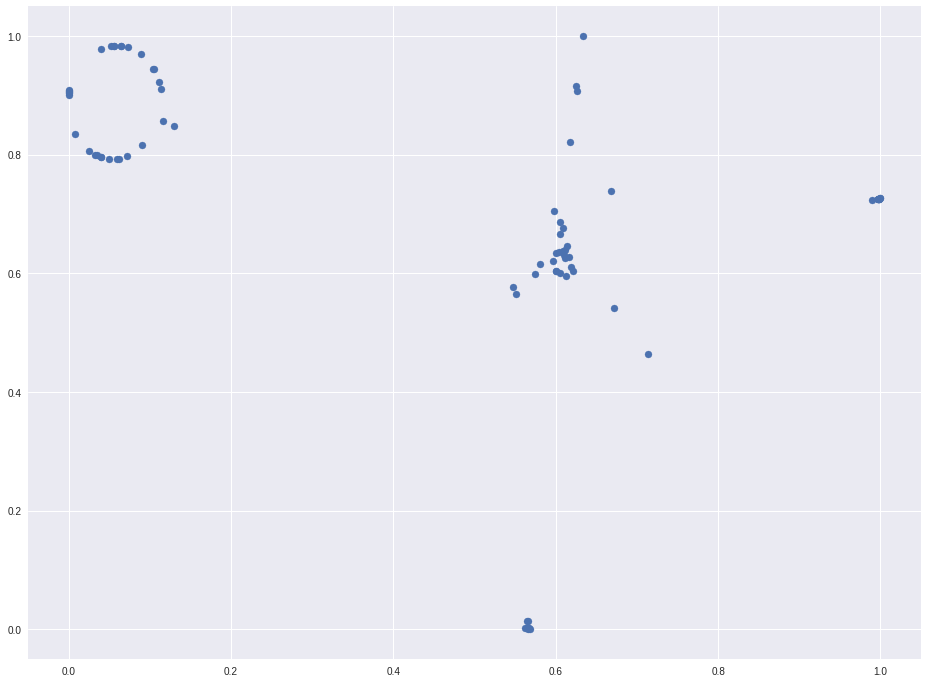

In [0]:
# create a 10 x 10 scatter plot to show where images are embedded
fig, ax = plt.subplots(figsize=[16, 12])
ax.scatter(x, y) 

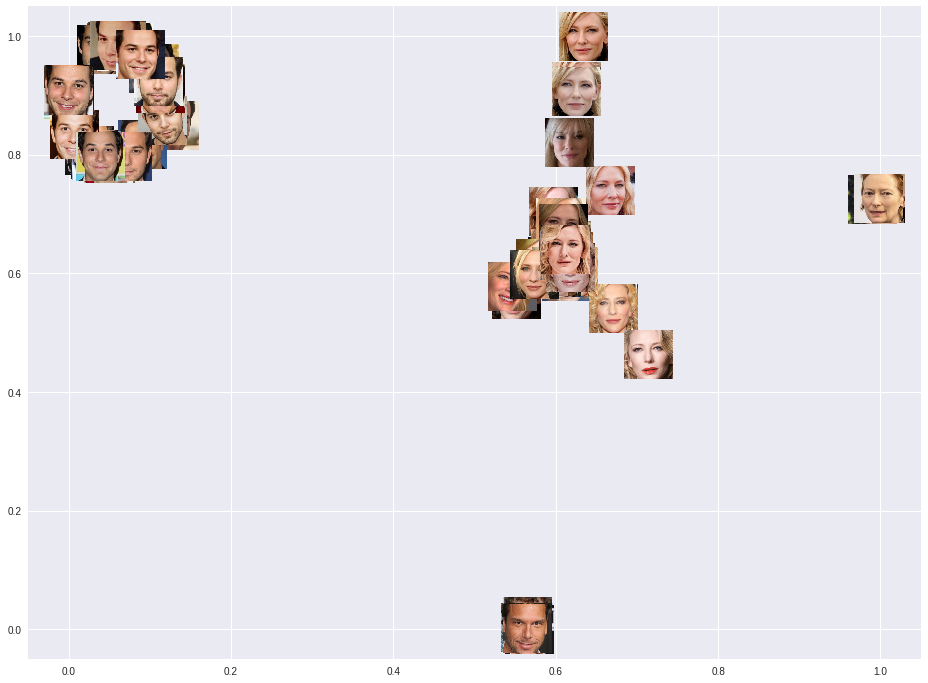

In [0]:
# add the images to the plot at 0.25 scale
for x_plot, y_plot, filename in zip(x, y, face_filenames):
  offset_img = OffsetImage(plt.imread(filename), zoom=0.2)
  ab = AnnotationBbox(offset_img, (x_plot, y_plot), frameon=False)
  ax.add_artist(ab)
fig

##5.1 Classification

---



###5.1.1 Handcrafted features (HOG)





In the previous section, we computed the HOG feature vectors for our training data using the optimal parameters for HOG pipeline. Now we focus on the classification by using SVM classifier. The role of this classifier is to recognise person A (class 0) and person B (class 1). The training data consists of HOG vectors of 40 facial images Person A and Person B. The test data consists of HOG vectors of 20 facial images Person A and Person B.

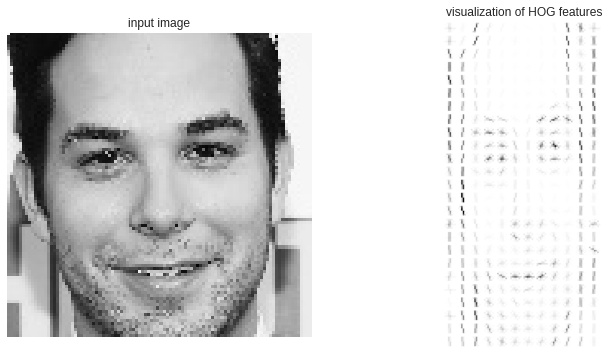

In [0]:
image = faces[0]
hog_vec,h_i ,hog_vis = create_hog_features(image)
fig, ax = plt.subplots(1, 2, figsize=(12, 6), subplot_kw=dict(xticks=[], yticks=[]))
ax[0].imshow(image, cmap='gray')
ax[0].set_title('input image')

ax[1].imshow(h_i)
ax[1].set_title('visualization of HOG features');

In [0]:
# Helper method to plot the confusion matrix 
def plot_confusion_matrix(cmx, vmax1=None, vmax2=None, vmax3=None):
    cmx_norm = 100*cmx / cmx.sum(axis=1, keepdims=True)
    cmx_zero_diag = cmx_norm.copy()
 
    np.fill_diagonal(cmx_zero_diag, 0)
 
    fig, ax = plt.subplots(ncols=3)
    fig.set_size_inches(12, 3)
    [a.set_xticks(range(6)) for a in ax]
    [a.set_yticks(range(6)) for a in ax]
 
    im1 = ax[0].imshow(cmx, vmax=vmax1)
    ax[0].set_title('as is')
    im2 = ax[1].imshow(cmx_norm, vmax=vmax2)
    ax[1].set_title('%')
    im3 = ax[2].imshow(cmx_zero_diag, vmax=vmax3)
    ax[2].set_title('% and 0 diagonal')
 
    dividers = [make_axes_locatable(a) for a in ax]
    cax1, cax2, cax3 = [divider.append_axes("right", size="5%", pad=0.1)
                        for divider in dividers]
 
    fig.colorbar(im1, cax=cax1)
    fig.colorbar(im2, cax=cax2)
    fig.colorbar(im3, cax=cax3)
    fig.tight_layout()
  
# the types appear in this order
print('\n Classes', sorted(np.unique(y_test)))



 Classes [0, 1]


[0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1]
Accuracy: 1.0


              precision    recall  f1-score   support

           0       1.00      1.00      1.00        10
           1       1.00      1.00      1.00        10

    accuracy                           1.00        20
   macro avg       1.00      1.00      1.00        20
weighted avg       1.00      1.00      1.00        20



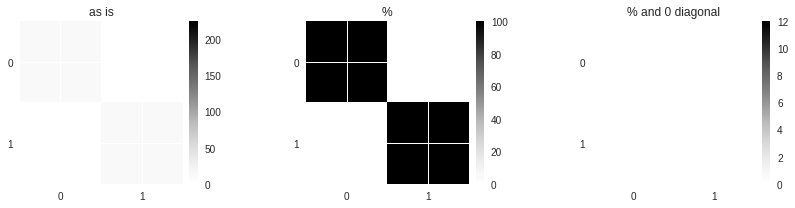

In [0]:
clf = svm.SVC()
params = {'orientations': 9, 'pixels_per_cell': (14, 14), 'cells_per_block': (2, 2), 'transform_sqrt':True, 'block_norm':'L2-Hys'}

clf.fit(training_data,y_train)
test_set = faces[20:30]+faces[50:60]
hog_faces, resulted_imgs, test_data = create_hog_features_for_images(test_set, params) 
y_pred = clf.predict(test_data)
print(y_pred)
print("Accuracy: "+str(accuracy_score(y_test, y_pred)))
print('\n')
print(classification_report(y_test, y_pred))
cmx_svm = confusion_matrix(y_test, y_pred)
plot_confusion_matrix(cmx_svm, vmax1=225, vmax2=100, vmax3=12)

From above it can be observed that the classification comes out to be 100% accurate when we have limited test images of Person A and B only.
We then expand the test data set to include celebrities who are lookalikes of the ones used in the trainig dataset and compute their hog vectors. We then classify it using SVM and plot its accuracy and confusion matrix below. Person A and C are to be classified as '0' and Person B and D are to classified as '1'.

[0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 0 1 0 0 0 0 0 0 1 0 1 1 0 1 1 1 1
 0 1 1]
Accuracy: 0.9


              precision    recall  f1-score   support

           0       0.90      0.90      0.90        20
           1       0.90      0.90      0.90        20

    accuracy                           0.90        40
   macro avg       0.90      0.90      0.90        40
weighted avg       0.90      0.90      0.90        40



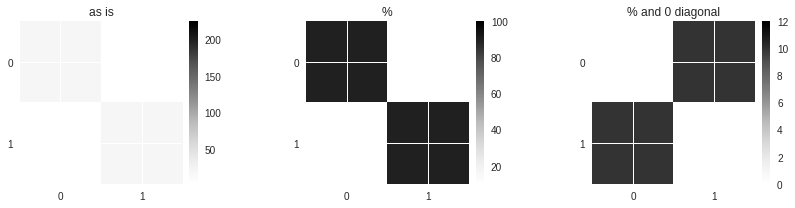

In [0]:
clf = svm.SVC()
params = {'orientations': 9, 'pixels_per_cell': (14, 14), 'cells_per_block': (2, 2), 'transform_sqrt':True, 'block_norm':'L2-Hys'}

clf.fit(training_data,y_train)
test_set = faces[20:30]+faces[50:60]+faces[60:70]+faces[70:80]
hog_faces, resulted_imgs, test_data = create_hog_features_for_images(test_set, params) 
y_pred = clf.predict(test_data)
print(y_pred)
print("Accuracy: "+str(accuracy_score(y_test_all, y_pred)))
print('\n')
print(classification_report(y_test_all, y_pred))
cmx_svm = confusion_matrix(y_test_all, y_pred)
plot_confusion_matrix(cmx_svm, vmax1=225, vmax2=100, vmax3=12)

The accuracy on complete data set comes out to be 0.9
We then perform Grid Search on SVM classifier and are able to improve the classification accuracy from 0.9 to 0.925.

In [0]:
grid = GridSearchCV(LinearSVC(), {'C': [1.0, 2.0, 4.0, 8.0]})
grid.fit(training_data,y_train)
grid.best_score_

0.95

In [0]:
grid.best_params_

{'C': 1.0}

In [0]:
model_svm = grid.best_estimator_
model_svm.fit(training_data,y_train)

LinearSVC(C=1.0, class_weight=None, dual=True, fit_intercept=True,
          intercept_scaling=1, loss='squared_hinge', max_iter=1000,
          multi_class='ovr', penalty='l2', random_state=None, tol=0.0001,
          verbose=0)

Plotting the confusion matrix below.

[0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 0 1 0 0 0 0 0 0 1 0 1 1 1 1 1 1 1
 0 1 1]
Accuracy: 0.925


                precision    recall  f1-score   support

  Skylar Astin       0.95      0.90      0.92        20
Cate Blanchett       0.90      0.95      0.93        20

      accuracy                           0.93        40
     macro avg       0.93      0.93      0.92        40
  weighted avg       0.93      0.93      0.92        40



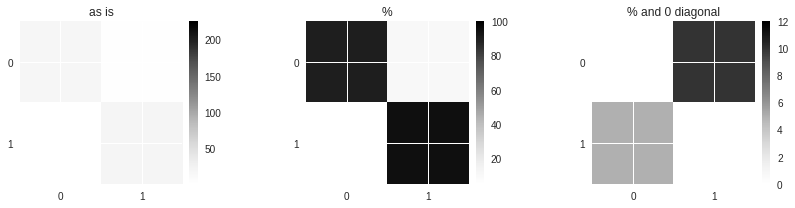

In [0]:
test_set = faces[20:30]+faces[50:60]+faces[60:70]+faces[70:80]
hog_faces, resulted_imgs, test_data = create_hog_features_for_images(test_set, params) 
y_pred = model_svm.predict(test_data)
print(y_pred)
print("Accuracy: "+str(accuracy_score(y_test_all, y_pred)))
print('\n')
print(classification_report(y_test_all, y_pred, target_names=target_names))
cmx_svm = confusion_matrix(y_test_all, y_pred)
plot_confusion_matrix(cmx_svm, vmax1=225, vmax2=100, vmax3=12)

Predicted Images are shown below. As it can be observed, 3 out of 40 test images, were predicted incorrectly. 
We enhance our algorithm to improve the classificiation accuracy for these incorrect images as well in section 5.3.

Classification Results using SVM


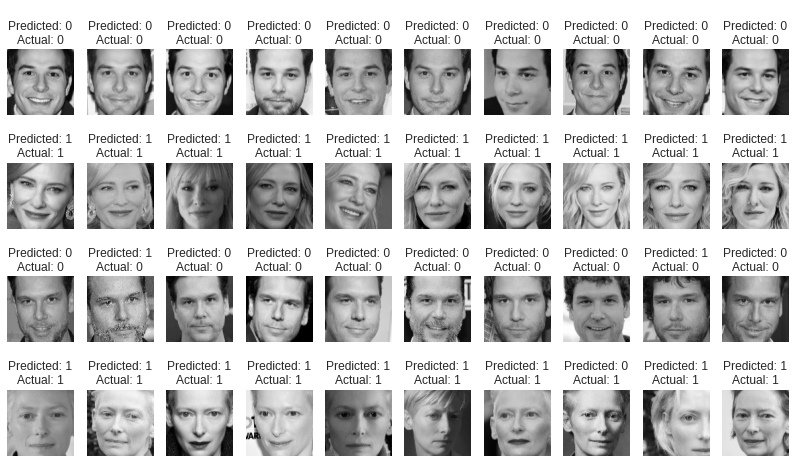

In [0]:
fig, ax = plt.subplots(4, 10, figsize=(14, 8))
print("Classification Results using SVM")
j = 0
for i, axi in enumerate(ax.flat):
    img = cv2.resize(resulted_imgs[j], (100,100))
    axi.imshow(img, cmap='gray')
    axi.set_title("\nPredicted: {}\nActual: {}".format(y_pred[j], y_test_all[j]))
    axi.axis('off')
    j += 1

###5.1.2 PCA

The challenges here are:

*   How to train a classifier in order to label testing images with 0 (A) or 1 (B)?
*   Which classification algorithm works the best under this circumstance?
*   How to improve/optimise the result?



We firstly build two functiions to plot our classification results and their predicted labels:

In [0]:
def plot_gallery(images, titles, h, w, n_row=4, n_col=5):
    """Helper function to plot a gallery of portraits"""
    plt.figure(figsize=(1.8 * n_col, 2.4 * n_row))
    plt.subplots_adjust(bottom=0, left=.01, right=.99, top=.90, hspace=.35)
    for i in range(n_row * n_col):
        plt.subplot(n_row, n_col, i + 1)
        plt.imshow(images[i].reshape((h, w)), cmap=plt.cm.gray)
        plt.title(titles[i], size=12)
        plt.xticks(())
        plt.yticks(())

def title(y_pred, y_test, target_names, i):
    pred_name = target_names[y_pred[i]].rsplit(' ', 1)[-1]
    true_name = target_names[y_test[i]].rsplit(' ', 1)[-1]
    return 'predicted: %s \n true:      %s' % (pred_name, true_name)

def plot_gallery_all(images, titles, h, w, n_row=4, n_col=10):
    """Helper function to plot a gallery of portraits"""
    plt.figure(figsize=(1.8 * n_col, 2.4 * n_row))
    plt.subplots_adjust(bottom=0, left=.01, right=.99, top=.90, hspace=.35)
    for i in range(n_row * n_col):
        plt.subplot(n_row, n_col, i + 1)
        plt.imshow(images[i].reshape((h, w)), cmap=plt.cm.gray)
        plt.title(titles[i], size=12)
        plt.xticks(())
        plt.yticks(())

Here we first make predictions on partial testing images - person A and person B. We will include all 40 testing images (ABCD) later.

The first algorithm we are going to try is **Support Vector Machines**.

####5.1.2.1 SVM

In [0]:
print("Fitting the classifier to the training set:")
t0 = time()
param_grid = {'C': [1e3, 5e3, 1e4, 5e4, 1e5],
              'gamma': [0.0001, 0.0005, 0.001, 0.005, 0.01, 0.1], }
clf = GridSearchCV(SVC(kernel='rbf', class_weight='balanced'), param_grid)
clf = clf.fit(X_train_pca, y_train)
print("... done in %0.3fs.\n" % (time() - t0))
print("Best estimator found by grid search:")
print(clf.best_estimator_)

Fitting the classifier to the training set:
... done in 0.212s.

Best estimator found by grid search:
SVC(C=1000.0, break_ties=False, cache_size=200, class_weight='balanced',
    coef0=0.0, decision_function_shape='ovr', degree=3, gamma=0.1, kernel='rbf',
    max_iter=-1, probability=False, random_state=None, shrinking=True,
    tol=0.001, verbose=False)


In [0]:
print("Predicting people's names on the test set:")
t0 = time()
y_pred_SVM = clf.predict(X_test_pca)
print("... done in %0.3fs.\n" % (time() - t0))

print(classification_report(y_test, y_pred_SVM, target_names=target_names))
print(confusion_matrix(y_test, y_pred_SVM, labels=range(n_classes)))

Predicting people's names on the test set:
... done in 0.000s.

                precision    recall  f1-score   support

  Skylar Astin       0.90      0.90      0.90        10
Cate Blanchett       0.90      0.90      0.90        10

      accuracy                           0.90        20
     macro avg       0.90      0.90      0.90        20
  weighted avg       0.90      0.90      0.90        20

[[9 1]
 [1 9]]


The result is not too bad, only 2 misclassifications!

Next we are going to test **Multilayer Perceptron**:

####5.1.2.2 MLP

In [0]:
clf = MLPClassifier()
clf = clf.fit(X_train_pca, y_train)

print("Predicting people's names on the test set")
t0 = time()
y_pred_MLP = clf.predict(X_test_pca)
print("done in %0.3fs" % (time() - t0))

print(classification_report(y_test, y_pred_MLP, target_names=target_names))
print(confusion_matrix(y_test, y_pred_MLP, labels=range(n_classes)))

Predicting people's names on the test set
done in 0.001s
                precision    recall  f1-score   support

  Skylar Astin       1.00      0.80      0.89        10
Cate Blanchett       0.83      1.00      0.91        10

      accuracy                           0.90        20
     macro avg       0.92      0.90      0.90        20
  weighted avg       0.92      0.90      0.90        20

[[ 8  2]
 [ 0 10]]


/usr/local/lib/python3.6/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning:

Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.



It even achieved better results! Only 1 mistake.

How about **Random Forest**?

####5.1.2.3 Random Forest

In [0]:
criterion = ["entropy","gini"]
min_weight_fraction_leaf = [0.001, 0.0025, 0.005, 0.0075, 0.009, 0.01]
class_weight=['balanced','balanced_subsample', None]
n_estimators = [10, 25, 50, 100, 250]
max_features = ['auto', 'sqrt', 'log2', None]
bootstrap = [True, False]
random_state = [0]
n_jobs=[1]
min_samples_leaf = [0.1, 0.2, 0.3, 0.4, 0.5]
min_samples_split = [0.1, 0.25, 0.5, 0.75, 0.9, 1.0]
param_grid = {'criterion': criterion,
               'min_weight_fraction_leaf':min_weight_fraction_leaf,
               'class_weight':class_weight,
               'n_estimators': n_estimators,
               'max_features': max_features,
               'bootstrap': bootstrap,
               'random_state': random_state,
               'n_jobs':n_jobs,
               'min_samples_leaf': min_samples_leaf,
               'min_samples_split': min_samples_split}

#clf = RandomizedSearchCV(RandomForestClassifier(), param_grid, n_iter = 500, cv = 5)
clf = RandomForestClassifier(bootstrap=False, class_weight='balanced',criterion='entropy', max_depth=None, max_features=None,
                             max_leaf_nodes=None, min_impurity_decrease=0.0,min_impurity_split=None, min_samples_leaf=0.3,
                             min_samples_split=0.5, min_weight_fraction_leaf=0.0025,n_estimators=100, n_jobs=1, 
                             oob_score=False, random_state=0,verbose=0, warm_start=False)
clf = clf.fit(X_train_pca, y_train)
print("done in %0.3fs" % (time() - t0))
#print("Best estimator found by random search:")
#print(clf.best_estimator_)

print("Predicting people's names on the test set")
t0 = time()
y_pred_RF = clf.predict(X_test_pca)
print("done in %0.3fs" % (time() - t0))

print(classification_report(y_test, y_pred_RF, target_names=target_names))
print(confusion_matrix(y_test, y_pred_RF, labels=range(n_classes)))

done in 0.137s
Predicting people's names on the test set
done in 0.011s
                precision    recall  f1-score   support

  Skylar Astin       0.70      0.70      0.70        10
Cate Blanchett       0.70      0.70      0.70        10

      accuracy                           0.70        20
     macro avg       0.70      0.70      0.70        20
  weighted avg       0.70      0.70      0.70        20

[[7 3]
 [3 7]]


The result of RF did not come out very well! Maybe we can try to improve it.

Here we will try to adopt **LDA (Linear discriminant analysis)** to try to improve the result. [2]

**LDA** is also closely related to PCA and factor analysis in that they both look for linear combinations of variables which best explain the data. LDA explicitly attempts to model the difference between the classes of data. PCA, in contrast, does not take into account any difference in class, and factor analysis builds the feature combinations based on differences rather than similarities. Discriminant analysis is also different from factor analysis in that it is not an interdependence technique: a distinction between independent variables and dependent variables (also called criterion variables) must be made.

####5.1.2.4 LDA

In [0]:
lda = LDA(n_components=1)
X_train_pca_lda = lda.fit_transform(X_train_pca, y_train)
X_test_pca_lda = lda.transform(X_test_pca)
X_test_all_pca_lda = lda.transform(X_test_all_pca)

####5.1.2.5 Random Forest after LDA

In [0]:
criterion = ["entropy","gini"]
min_weight_fraction_leaf = [0.001, 0.0025, 0.005, 0.0075, 0.009, 0.01]
class_weight=['balanced','balanced_subsample', None]
n_estimators = [10, 25, 50, 100, 250]
max_features = ['auto', 'sqrt', 'log2', None]
bootstrap = [True, False]
random_state = [0]
n_jobs=[1]
min_samples_leaf = [0.1, 0.2, 0.3, 0.4, 0.5]
min_samples_split = [0.1, 0.25, 0.5, 0.75, 0.9, 1.0]
param_grid = {'criterion': criterion,
               'min_weight_fraction_leaf':min_weight_fraction_leaf,
               'class_weight':class_weight,
               'n_estimators': n_estimators,
               'max_features': max_features,
               'bootstrap': bootstrap,
               'random_state': random_state,
               'n_jobs':n_jobs,
               'min_samples_leaf': min_samples_leaf,
               'min_samples_split': min_samples_split}

#clf = RandomizedSearchCV(RandomForestClassifier(), param_grid, n_iter = 500, cv = 5)
clf = RandomForestClassifier(bootstrap=False, class_weight='balanced',criterion='entropy', max_depth=None, max_features=None,
                             max_leaf_nodes=None, min_impurity_decrease=0.0,min_impurity_split=None, min_samples_leaf=0.3,
                             min_samples_split=0.5, min_weight_fraction_leaf=0.0025,n_estimators=100, n_jobs=1, 
                             oob_score=False, random_state=0,verbose=0, warm_start=False)
clf = clf.fit(X_train_pca_lda, y_train)
print("done in %0.3fs" % (time() - t0))
#print("Best estimator found by random search:")
#print(clf.best_estimator_)

print("Predicting people's names on the test set")
t0 = time()
y_pred_RF = clf.predict(X_test_pca_lda)
print("done in %0.3fs" % (time() - t0))

print(classification_report(y_test, y_pred_RF, target_names=target_names))
print(confusion_matrix(y_test, y_pred_RF, labels=range(n_classes)))

done in 0.156s
Predicting people's names on the test set
done in 0.012s
                precision    recall  f1-score   support

  Skylar Astin       0.89      0.80      0.84        10
Cate Blanchett       0.82      0.90      0.86        10

      accuracy                           0.85        20
     macro avg       0.85      0.85      0.85        20
  weighted avg       0.85      0.85      0.85        20

[[8 2]
 [1 9]]


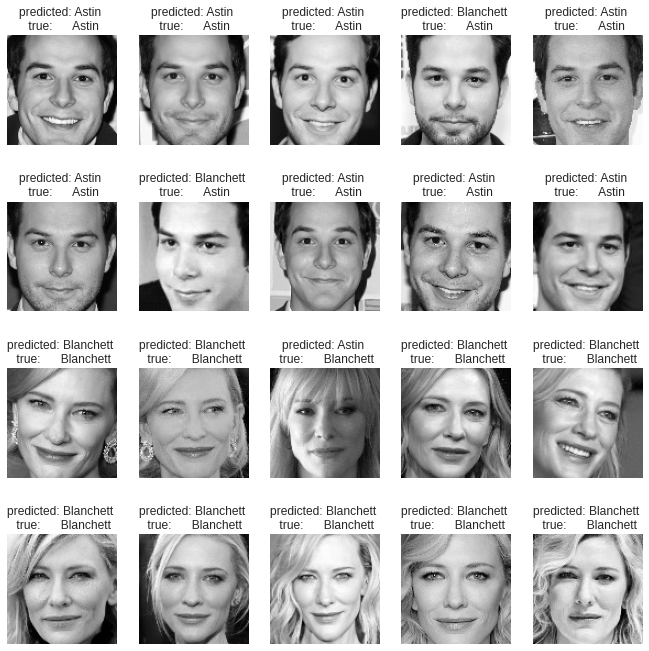

In [0]:
prediction_titles = [title(y_pred_RF, y_test, target_names, i)
                     for i in range(y_pred_RF.shape[0])]
h = 100
w = 100
plot_gallery(X_test, prediction_titles, h, w)

We see a huge improvement here for RF! Now only one image of person B is misclassified.

####5.1.2.6 SVM after LDA

In [0]:
print("Fitting the classifier to the training set:")
t0 = time()
param_grid = {'C': [1e3, 5e3, 1e4, 5e4, 1e5],
              'gamma': [0.0001, 0.0005, 0.001, 0.005, 0.01, 0.1], }
clf = GridSearchCV(SVC(kernel='rbf', class_weight='balanced'), param_grid)
clf = clf.fit(X_train_pca, y_train)
print("... done in %0.3fs.\n" % (time() - t0))
print("Best estimator found by grid search:")
print(clf.best_estimator_)

Fitting the classifier to the training set:
... done in 0.274s.

Best estimator found by grid search:
SVC(C=1000.0, break_ties=False, cache_size=200, class_weight='balanced',
    coef0=0.0, decision_function_shape='ovr', degree=3, gamma=0.1, kernel='rbf',
    max_iter=-1, probability=False, random_state=None, shrinking=True,
    tol=0.001, verbose=False)


In [0]:
print("Predicting people's names on the test set:")
t0 = time()
y_pred_SVM = clf.predict(X_test_pca)
print("... done in %0.3fs.\n" % (time() - t0))

print(classification_report(y_test, y_pred_SVM, target_names=target_names))
print(confusion_matrix(y_test, y_pred_SVM, labels=range(n_classes)))

Predicting people's names on the test set:
... done in 0.000s.

                precision    recall  f1-score   support

  Skylar Astin       0.90      0.90      0.90        10
Cate Blanchett       0.90      0.90      0.90        10

      accuracy                           0.90        20
     macro avg       0.90      0.90      0.90        20
  weighted avg       0.90      0.90      0.90        20

[[9 1]
 [1 9]]


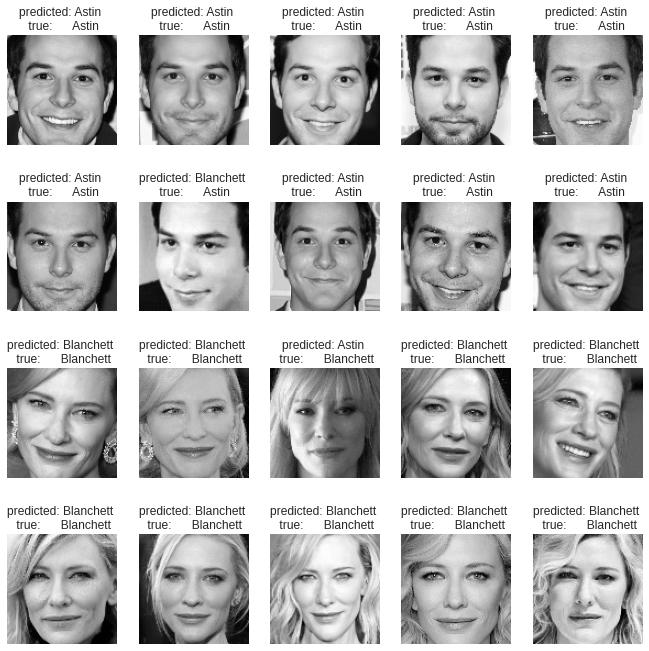

In [0]:
prediction_titles = [title(y_pred_SVM, y_test, target_names, i)
                     for i in range(y_pred_SVM.shape[0])]
h = 100
w = 100
plot_gallery(X_test, prediction_titles, h, w)

Now we predict on our full dataset which contains person C and D:

In [0]:
print("Predicting people's names on the full test set:")
t0 = time()
y_pred_SVM_all = clf.predict(X_test_all_pca)
print("... done in %0.3fs.\n" % (time() - t0))

print(classification_report(y_test_all, y_pred_SVM_all, target_names=target_names))
print(confusion_matrix(y_test_all, y_pred_SVM_all, labels=range(n_classes)))

Predicting people's names on the full test set:
... done in 0.001s.

                precision    recall  f1-score   support

  Skylar Astin       0.81      0.85      0.83        20
Cate Blanchett       0.84      0.80      0.82        20

      accuracy                           0.82        40
     macro avg       0.83      0.82      0.82        40
  weighted avg       0.83      0.82      0.82        40

[[17  3]
 [ 4 16]]


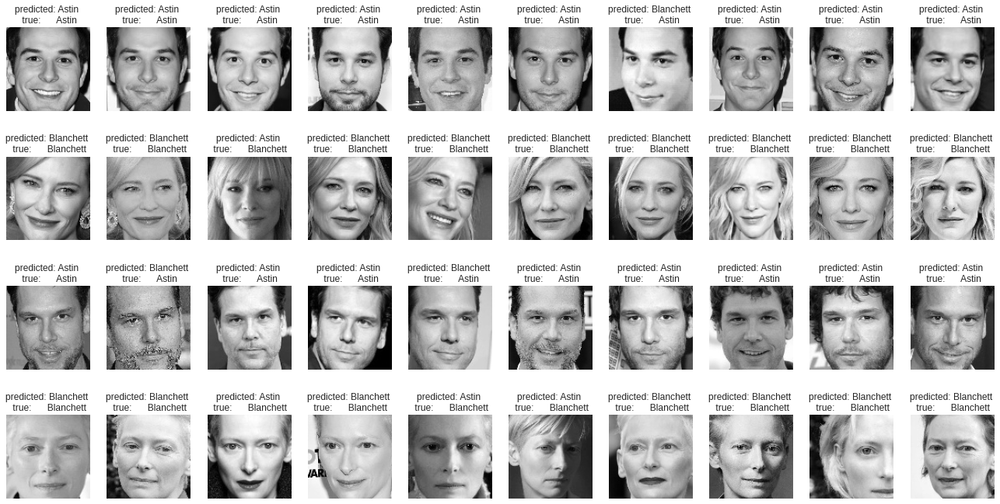

In [0]:
prediction_titles = [title(y_pred_SVM_all, y_test_all, target_names, i)
                     for i in range(y_pred_SVM_all.shape[0])]
h = 100
w = 100
plot_gallery_all(X_test_all, prediction_titles, h, w)

####5.1.2.7 MLP after LDA

In [0]:
clf = MLPClassifier()
clf = clf.fit(X_train_pca, y_train)

print("Predicting people's names on the test set")
t0 = time()
y_pred_MLP = clf.predict(X_test_pca)
print("done in %0.3fs" % (time() - t0))

print(classification_report(y_test, y_pred_MLP, target_names=target_names))
print(confusion_matrix(y_test, y_pred_MLP, labels=range(n_classes)))

Predicting people's names on the test set
done in 0.000s
                precision    recall  f1-score   support

  Skylar Astin       0.89      0.80      0.84        10
Cate Blanchett       0.82      0.90      0.86        10

      accuracy                           0.85        20
     macro avg       0.85      0.85      0.85        20
  weighted avg       0.85      0.85      0.85        20

[[8 2]
 [1 9]]


/usr/local/lib/python3.6/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:571: ConvergenceWarning:

Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.



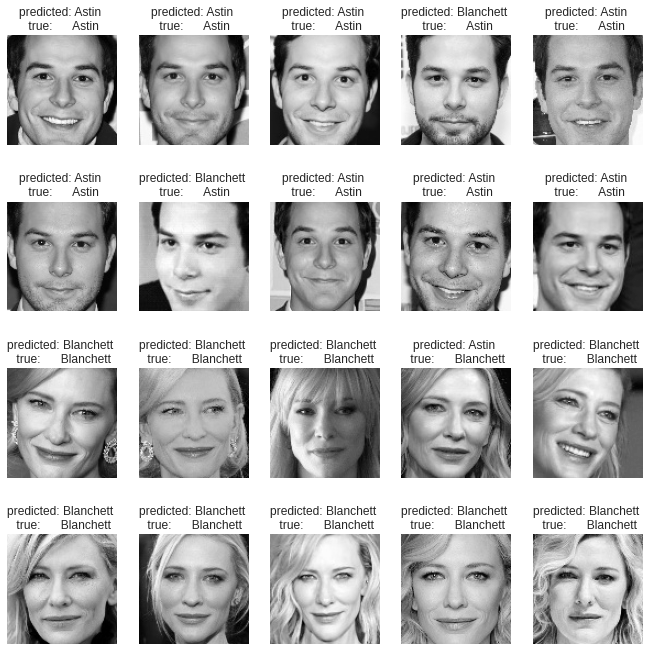

In [0]:
prediction_titles = [title(y_pred_MLP, y_test, target_names, i)
                     for i in range(y_pred_MLP.shape[0])]
h = 100
w = 100
plot_gallery(X_test, prediction_titles, h, w)

Now we predict on our full dataset which contains person C and D:

In [0]:
print("Predicting people's names on the full test set:")
t0 = time()
y_pred_MLP_all = clf.predict(X_test_all_pca)
print("... done in %0.3fs.\n" % (time() - t0))

print(classification_report(y_test_all, y_pred_MLP_all, target_names=target_names))
print(confusion_matrix(y_test_all, y_pred_MLP_all, labels=range(n_classes)))

Predicting people's names on the full test set:
... done in 0.001s.

                precision    recall  f1-score   support

  Skylar Astin       0.89      0.85      0.87        20
Cate Blanchett       0.86      0.90      0.88        20

      accuracy                           0.88        40
     macro avg       0.88      0.88      0.87        40
  weighted avg       0.88      0.88      0.87        40

[[17  3]
 [ 2 18]]


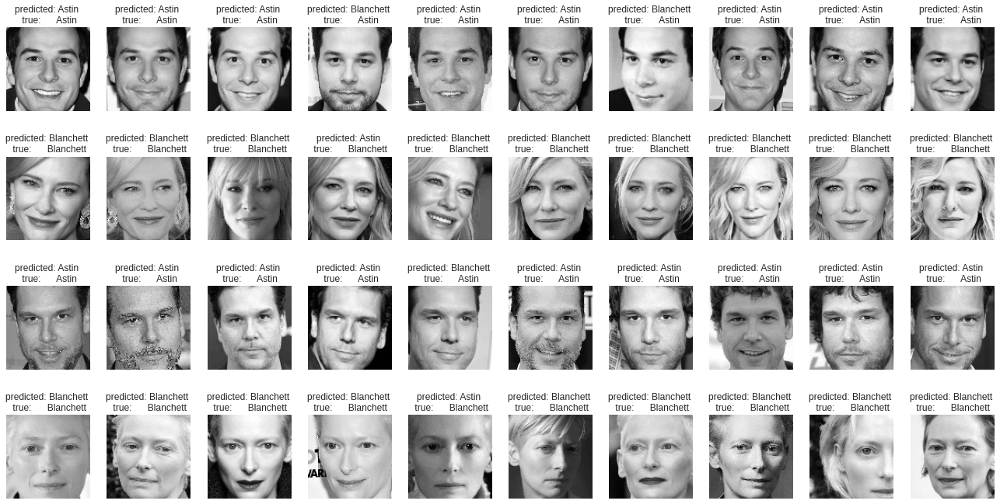

In [0]:
prediction_titles = [title(y_pred_MLP_all, y_test_all, target_names, i)
                     for i in range(y_pred_MLP_all.shape[0])]
h = 100
w = 100
plot_gallery_all(X_test_all, prediction_titles, h, w)

####5.1.2.8 Logistic Regression after LDA

In [0]:
print("Fitting the classifier to the training set:")
t0 = time()
# all parameters not specified are set to their defaults
logisticRegr = LogisticRegression()
logisticRegr.fit(X_train_pca, y_train)
print("... done in %0.3fs.\n" % (time() - t0))

Fitting the classifier to the training set:
... done in 0.005s.



In [0]:
print("Predicting people's names on the test set:")
t0 = time()
y_pred_LR = logisticRegr.predict(X_test_pca)
print("... done in %0.3fs.\n" % (time() - t0))

print(classification_report(y_test, y_pred_LR, target_names=target_names))
print(confusion_matrix(y_test, y_pred_LR, labels=range(n_classes)))

Predicting people's names on the test set:
... done in 0.000s.

                precision    recall  f1-score   support

  Skylar Astin       1.00      0.80      0.89        10
Cate Blanchett       0.83      1.00      0.91        10

      accuracy                           0.90        20
     macro avg       0.92      0.90      0.90        20
  weighted avg       0.92      0.90      0.90        20

[[ 8  2]
 [ 0 10]]


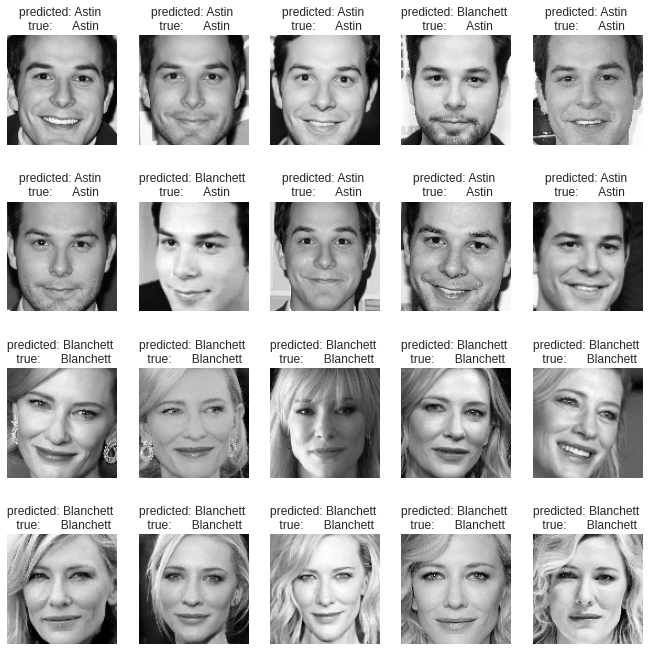

In [0]:
prediction_titles = [title(y_pred_LR, y_test, target_names, i)
                     for i in range(y_pred_LR.shape[0])]
h = 100
w = 100
plot_gallery(X_test, prediction_titles, h, w)

Now we predict on our full dataset which contains person C and D:

In [0]:
print("Predicting people's names on the full test set:")
t0 = time()
y_pred_LR_all = logisticRegr.predict(X_test_all_pca)
print("... done in %0.3fs.\n" % (time() - t0))

print(classification_report(y_test_all, y_pred_LR_all, target_names=target_names))
print(confusion_matrix(y_test_all, y_pred_LR_all, labels=range(n_classes)))

Predicting people's names on the full test set:
... done in 0.000s.

                precision    recall  f1-score   support

  Skylar Astin       1.00      0.85      0.92        20
Cate Blanchett       0.87      1.00      0.93        20

      accuracy                           0.93        40
     macro avg       0.93      0.93      0.92        40
  weighted avg       0.93      0.93      0.92        40

[[17  3]
 [ 0 20]]


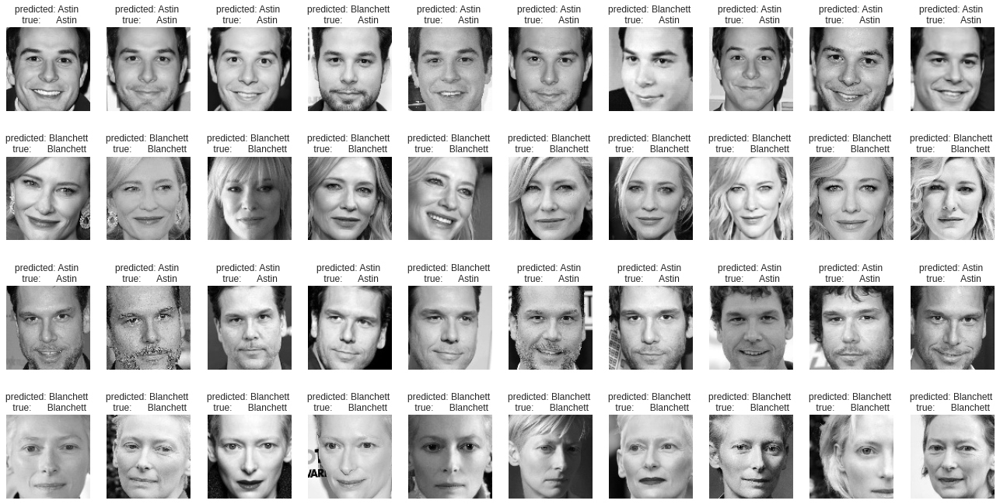

In [0]:
prediction_titles = [title(y_pred_LR_all, y_test_all, target_names, i)
                     for i in range(y_pred_LR_all.shape[0])]
h = 100
w = 100
plot_gallery_all(X_test_all, prediction_titles, h, w)

####5.1.2.9 k-NN after LDA

In [0]:
knnclassifier = KNeighborsClassifier(n_neighbors=5)
knnclassifier.fit(X_train_pca_lda, y_train)

KNeighborsClassifier(algorithm='auto', leaf_size=30, metric='minkowski',
                     metric_params=None, n_jobs=None, n_neighbors=5, p=2,
                     weights='uniform')

In [0]:
print("Predicting people's names on the test set:")
t0 = time()
y_pred_knn = knnclassifier.predict(X_test_pca_lda)
print("... done in %0.3fs.\n" % (time() - t0))

print(classification_report(y_test, y_pred_knn, target_names=target_names))
print(confusion_matrix(y_test, y_pred_knn, labels=range(n_classes)))

Predicting people's names on the test set:
... done in 0.003s.

                precision    recall  f1-score   support

  Skylar Astin       1.00      0.80      0.89        10
Cate Blanchett       0.83      1.00      0.91        10

      accuracy                           0.90        20
     macro avg       0.92      0.90      0.90        20
  weighted avg       0.92      0.90      0.90        20

[[ 8  2]
 [ 0 10]]


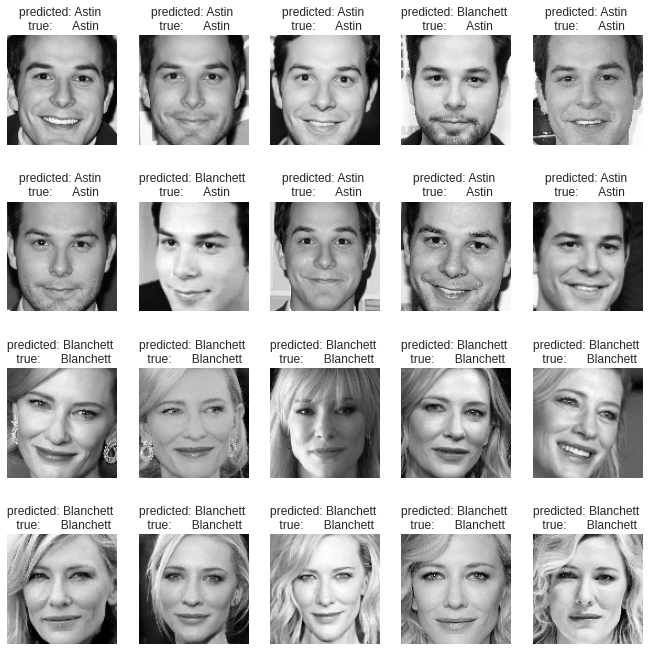

In [0]:
prediction_titles = [title(y_pred_knn, y_test, target_names, i)
                     for i in range(y_pred_knn.shape[0])]
h = 100
w = 100
plot_gallery(X_test, prediction_titles, h, w)

Now we predict on our full dataset which contains person C and D:

In [0]:
print("Predicting people's names on the full test set:")
t0 = time()
y_pred_knn_all = knnclassifier.predict(X_test_all_pca_lda)
print("... done in %0.3fs.\n" % (time() - t0))

print(classification_report(y_test_all, y_pred_knn_all, target_names=target_names))
print(confusion_matrix(y_test_all, y_pred_knn_all, labels=range(n_classes)))

Predicting people's names on the full test set:
... done in 0.003s.

                precision    recall  f1-score   support

  Skylar Astin       1.00      0.85      0.92        20
Cate Blanchett       0.87      1.00      0.93        20

      accuracy                           0.93        40
     macro avg       0.93      0.93      0.92        40
  weighted avg       0.93      0.93      0.92        40

[[17  3]
 [ 0 20]]


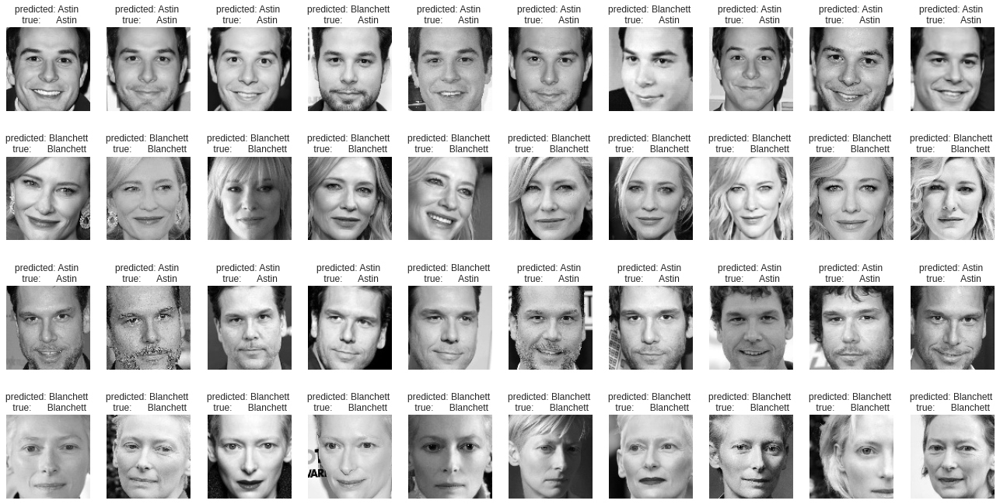

In [0]:
prediction_titles = [title(y_pred_knn_all, y_test_all, target_names, i)
                     for i in range(y_pred_knn_all.shape[0])]
h = 100
w = 100
plot_gallery_all(X_test_all, prediction_titles, h, w)

###5.1.3 Transfer learning

Classify an image as A or B, with a confidence level

In [0]:
activations_a = activations[0:30]
activations_b = activations[30:60]

In [0]:
# train a KNN model with k = 30 for only person a and person b's activations
knn = NearestNeighbors(n_neighbors=30, metric="cosine")
knn.fit(activations_a + activations_b)

NearestNeighbors(algorithm='auto', leaf_size=30, metric='cosine',
                 metric_params=None, n_jobs=None, n_neighbors=30, p=2,
                 radius=1.0)

In [0]:
def classify(filename):
  # for an image, return person a or b
  activation = filename_to_activation(filename)
  neigh_dist, neigh_ind = knn.kneighbors([ activation ])
  neigh_dist, neigh_ind = neigh_dist[0], neigh_ind[0]
  a_votes = 0
  b_votes = 0
  for i in neigh_ind:
    if i < 30:
      a_votes += 1
    elif i < 60:
      b_votes += 1
  if a_votes > b_votes:
    return "A", a_votes / (a_votes + b_votes)
  elif a_votes < b_votes:
    return "B", b_votes / (a_votes + b_votes)
  else:
    return "Undecided"

In [0]:
# get a random sample from person C
person_c_file = face_filenames[ random.randint(60,69) ]
# this should return 'A' with a high confience
classify(person_c_file)

('A', 1.0)

In [0]:
# get a random sample from person C
person_d_file = face_filenames[ random.randint(70,79) ]
# this should return 'A' with a high confience
classify(person_d_file)

('B', 1.0)

Plot a gallery of images and their corresponding classificaitons

In [0]:
def plot_gallery_color(images, titles, h, w, n_row=4, n_col=5):
    """Helper function to plot a gallery of portraits"""
    plt.figure(figsize=(1.8 * n_col, 2.4 * n_row))
    plt.subplots_adjust(bottom=0, left=.01, right=.99, top=.90, hspace=.35)
    for i in range(n_row * n_col):
        plt.subplot(n_row, n_col, i + 1)
        plt.imshow(images[i].reshape((h, w, 3)), cmap=plt.cm.gray)
        plt.title(titles[i], size=12)
        plt.xticks(())
        plt.yticks(())

In [0]:
# classify all images of person C & person D
classifications = [ classify(filename) for filename in face_filenames[60:80] ]

In [0]:
face_filenames[65]

'/content/data/FaceData/ProcessedData/Color/Cook_Face_6.jpg'

In [0]:
# format the strings
pretty_classifications = [ "Person {} ({}%)".format(person, str(error * 100)[:4]) for (person, error) in classifications ]
pretty_classifications

['Person A (100.%)',
 'Person A (100.%)',
 'Person A (100.%)',
 'Person A (96.6%)',
 'Person A (100.%)',
 'Person A (96.6%)',
 'Person A (100.%)',
 'Person A (100.%)',
 'Person A (96.6%)',
 'Person A (100.%)',
 'Person B (100.%)',
 'Person B (100.%)',
 'Person B (100.%)',
 'Person B (100.%)',
 'Person B (100.%)',
 'Person B (100.%)',
 'Person B (100.%)',
 'Person B (100.%)',
 'Person B (100.%)',
 'Person B (100.%)']

In [0]:
from PIL import Image
images = [cv2.cvtColor(cv2.imread(filename), cv2.COLOR_BGR2RGB) for filename in face_filenames[60:80] ]

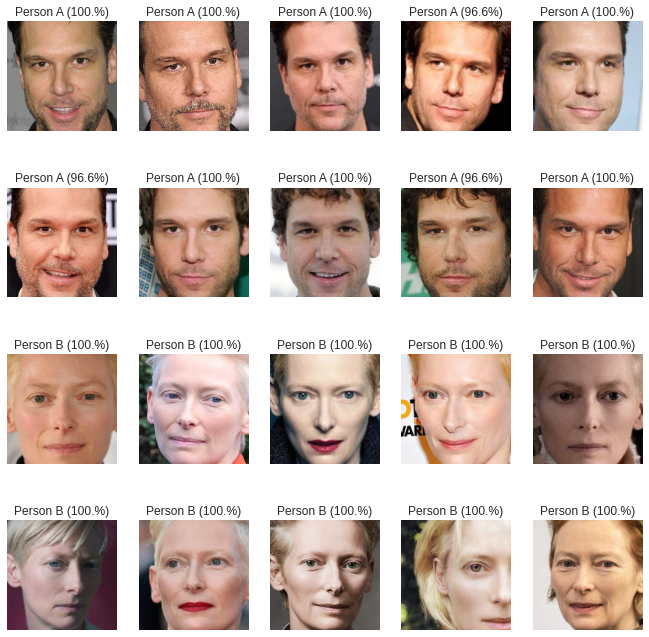

In [0]:
plot_gallery_color(images, pretty_classifications, 244, 244)

###5.1.4 Discussion

####HOG:
Since HOG classifiers were first introduced in 1986, they are not as powerful as the modern neural network classifiers and may break down in complex scenes. However, advantage of using HOG based classifier is that they can be extracted via CPUs of a laptop instead of GPUs. Additionally they can be trained and evlauated very fast. Here HOG features were calculated using 9 degree bings. Using HOG + SVM classifier, we were able to achieve the accuracy of 0.925. However, this accuracy has been further improved in section 5.3.1 after modifying the algorithm.

####PCA: 

We had the best result from PCA+LDA+SVM/MLP.


*   There are two principal algorithms for dimensionality reduction: Linear Discriminant Analysis (LDA) and Principal Component Analysis (PCA). The basic difference between these two is that LDA uses information of classes to find new features in order to maximize its separability while PCA uses the variance of each feature to do the same. In this context, LDA can be consider a supervised algorithm and PCA an unsupervised algorithm.
*   PCA the algorithm itself uses the concepts of variance matrix, covariance matrix, eigenvector and eigenvalues pairs to perform the process, providing a set of eigenvectors and its respectively eigenvalues as a result.
*   Our result should work better than HOG as HOG works as a very old machine learning algorithm with handcrafted features. With dimensionality reduction, SVM and multilayer perceptrons may be able to make the work of feature manipulation easier and significantly improve the classification accuracy.
*   Regarding to reflections, there are some specific face images which are not typically look alike the person themselves, which actually produced inaccurate results, this may be caused when reconstructing the faces and extract eigenfaces. 




####Transfer learning:
As you can see, the pretrained network's activations of person A & person B are close to their lookalikes, as always 30/30 or 29/30 of the nearest neighbours of a persons activations are those of their lookalike.

##5.2 Identification

---



### 5.2.1 HOG

In this section, we compute the similarity between the training and the test images using Euclidean Distance and then find the K nearest neighbours of an input image based on the similarity score. Here K is chosen as 5. First we choose a random image with person A or B from the test data and find 5 most similar looking faces for it from the training images.

In [0]:
n_neighbors = 5
model = NearestNeighbors(n_neighbors=n_neighbors, algorithm='brute', metric='euclidean')
nbrs = model.fit(training_data, y_train)
value = randint(0, 20)
distances, indices = nbrs.kneighbors([test_data[value]])

print("Indices: ", indices)
print("Distances: ",distances)

Indices:  [[19  4  7  8  1]]
Distances:  [[3.35583253 3.68650139 3.73348103 4.15686408 4.17296913]]


0
Similarity Scores from original image


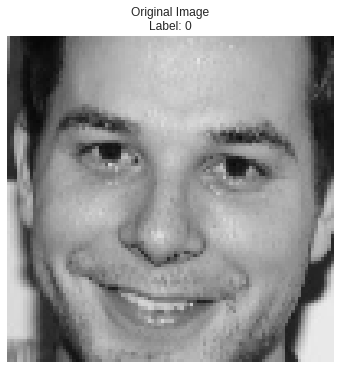

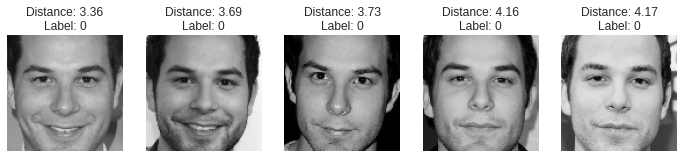

In [0]:
fig, ax = plt.subplots(1, 1, figsize=(12, 6), subplot_kw=dict(xticks=[], yticks=[]))
original = cv2.resize(resulted_imgs[value], (100,100))
ax.imshow(original, cmap='gray')
ax.set_title("Original Image\nLabel: {}".format(y_test_all[value]) )
fig, ax = plt.subplots(1, n_neighbors, figsize=(12, 6))
print(y_pred[value])
print("Similarity Scores from original image")
for i, axi in enumerate(ax.flat):
    img = cv2.resize(training_images[indices[0][i]], (100,100))
    axi.imshow(img, cmap='gray')
    axi.set_title("Distance: {}\nLabel: {}".format(round(distances[0][i], 2), y_train[indices[0][i]]))
    axi.axis('off')

Next we choose a random image from persons C and D in the test data and find the 8 most similar faces with it from the training data. The goal here is to identify the lookalikes of the celebrities given as input.

In [0]:
n_neighbors = 8
model = NearestNeighbors(n_neighbors=n_neighbors, algorithm='brute', metric='euclidean')
nbrs = model.fit(training_data, y_train)
value = randint(20, 39)
print(value)
distances, indices = nbrs.kneighbors([test_data[value]])
print(indices)
distances

28
[[25 21 28 19 37 35  0 34]]


array([[4.76381758, 4.82932478, 4.83809217, 4.93870708, 4.95470304,
        4.96198626, 4.98198048, 4.99301211]])

Similarity Scores from original image


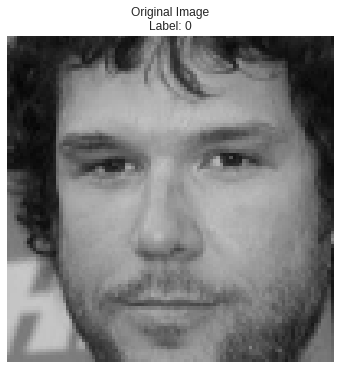

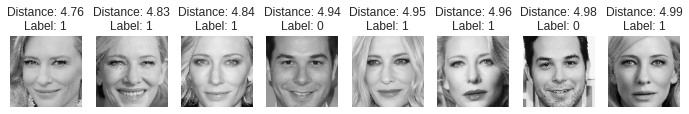

In [0]:
fig, ax = plt.subplots(1, 1, figsize=(12, 6), subplot_kw=dict(xticks=[], yticks=[]))
original = cv2.resize(resulted_imgs[value], (100,100))
ax.imshow(original, cmap='gray')
ax.set_title("Original Image\nLabel: {}".format(y_test_all[value]) )
fig, ax = plt.subplots(1, n_neighbors, figsize=(12, 6))
# print(y_pred[value])
print("Similarity Scores from original image")
for i, axi in enumerate(ax.flat):
    img = cv2.resize(training_images[indices[0][i]], (100,100))
    axi.imshow(img, cmap='gray')
    axi.set_title("Distance: {}\nLabel: {}".format(round(distances[0][i], 2), y_train[indices[0][i]]))
    axi.axis('off')

As we see from above, the Identification is not very accurate when we have a large k. For shorter nighbourhood, identification works fine.

###5.2.2 PCA

We’ll use Python’s machine learning library scikit-learn for finding nearest neighbors of the query features; that is, features that represent a query image. We train a nearest-neighbor model using the brute-force algorithm to find the nearest five neighbors based on Euclidean distance.

In [0]:
neighbors = NearestNeighbors(n_neighbors=5, algorithm='brute',
metric='euclidean').fit(X_train_pca_lda, y_train)

Now we have both the indices and distances of the nearest five neighbors of the very first query feature (which represents the first image). Notice the quick execution of the first step - the training step. Unlike training most machine learning models, which can take from several minutes to hours on large datasets, instantiating the nearest-neighbor model is instantaneous because at training time there isn’t much processing. This is also called lazy learning because all the processing is deferred to classification or inference time.

Here we have 20 testing faces, so we pick a random number from 20 then search the most similar k faces, in this setting, 5.

In [0]:
random_image_index = random.randint(0,39)
distances, indices = neighbors.kneighbors([X_test_all_pca_lda[random_image_index]])

The face we picked is shown below:

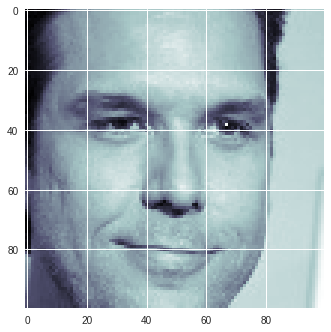

In [0]:
original = np.reshape(X_test_all[random_image_index], (100,100))
plt.imshow(original, cmap=plt.cm.bone, interpolation='nearest')

Now that we know the indices and distances of the 5 most similar faces below:

In [0]:
for i in range(5):
    print("Indice:", indices[0][i], "\nDistance:", distances[0][i])

Indice: 35 
Distance: 0.29889036557697657
Indice: 32 
Distance: 0.3006741046087601
Indice: 12 
Distance: 0.39342088110947326
Indice: 24 
Distance: 0.42810459280577207
Indice: 27 
Distance: 0.6106040079287148


Now we are going to visualise these faces:

In [0]:
nn1 = np.reshape(X_train[indices[0][0]], (100,100))
nn2 = np.reshape(X_train[indices[0][1]], (100,100))
nn3 = np.reshape(X_train[indices[0][2]], (100,100))
nn4 = np.reshape(X_train[indices[0][3]], (100,100))
nn5 = np.reshape(X_train[indices[0][4]], (100,100))

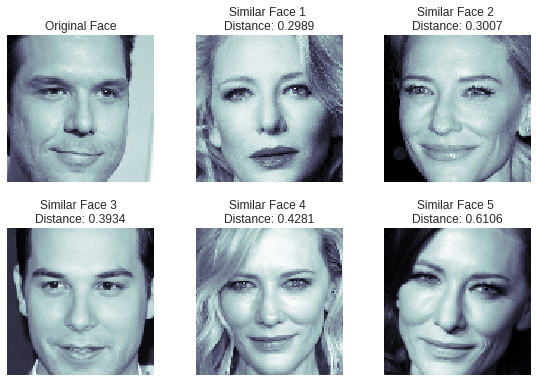

In [0]:
fig, axes = plt.subplots(nrows=2, ncols=3)
fig.tight_layout() 

plt.subplot(2, 3, 1)
plt.imshow(original,cmap=plt.cm.bone, interpolation='nearest')
plt.title("Original Face", size=12)
plt.xticks(())
plt.yticks(())
plt.subplot(2, 3, 2)
plt.imshow(nn1,cmap=plt.cm.bone, interpolation='nearest')
plt.title("Similar Face 1 \n"+"Distance: "+str(round(distances[0][0], 4)), size=12)
plt.xticks(())
plt.yticks(())
plt.subplot(2, 3, 3)
plt.imshow(nn2,cmap=plt.cm.bone, interpolation='nearest')
plt.title("Similar Face 2 \n"+"Distance: "+str(round(distances[0][1], 4)), size=12)
plt.xticks(())
plt.yticks(())
plt.subplot(2, 3, 4)
plt.imshow(nn3,cmap=plt.cm.bone, interpolation='nearest')
plt.title("Similar Face 3 \n"+"Distance: "+str(round(distances[0][2], 4)), size=12)
plt.xticks(())
plt.yticks(())
plt.subplot(2, 3, 5)
plt.imshow(nn4,cmap=plt.cm.bone, interpolation='nearest')
plt.title("Similar Face 4 \n"+"Distance: "+str(round(distances[0][3], 4)), size=12)
plt.xticks(())
plt.yticks(())
plt.subplot(2, 3, 6)
plt.imshow(nn5,cmap=plt.cm.bone, interpolation='nearest')
plt.title("Similar Face 5 \n"+"Distance: "+str(round(distances[0][4], 4)), size=12)
plt.xticks(())
plt.yticks(())

plt.show()

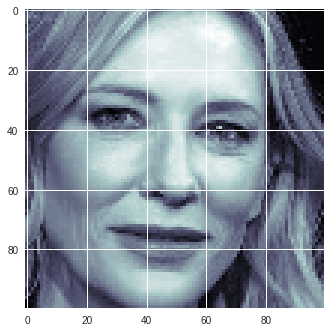

In [0]:
neighbors = NearestNeighbors(n_neighbors=5, algorithm='kd_tree',
metric='euclidean').fit(X_train_pca_lda, y_train)

random_image_index = random.randint(0,39)
distances, indices = neighbors.kneighbors([X_test_all_pca_lda[random_image_index]])

original = np.reshape(X_test_all[random_image_index], (100,100))
plt.imshow(original, cmap=plt.cm.bone, interpolation='nearest')

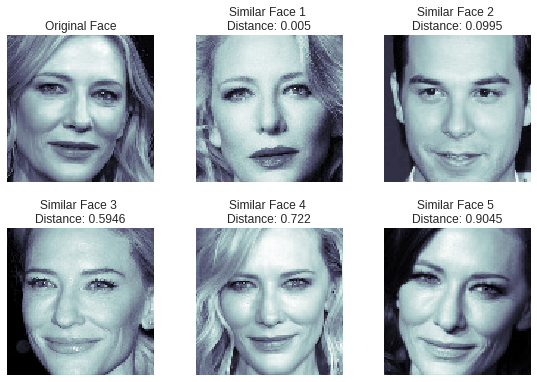

In [0]:
nn1 = np.reshape(X_train[indices[0][0]], (100,100))
nn2 = np.reshape(X_train[indices[0][1]], (100,100))
nn3 = np.reshape(X_train[indices[0][2]], (100,100))
nn4 = np.reshape(X_train[indices[0][3]], (100,100))
nn5 = np.reshape(X_train[indices[0][4]], (100,100))

fig, axes = plt.subplots(nrows=2, ncols=3)
fig.tight_layout() 

plt.subplot(2, 3, 1)
plt.imshow(original,cmap=plt.cm.bone, interpolation='nearest')
plt.title("Original Face", size=12)
plt.xticks(())
plt.yticks(())
plt.subplot(2, 3, 2)
plt.imshow(nn1,cmap=plt.cm.bone, interpolation='nearest')
plt.title("Similar Face 1 \n"+"Distance: "+str(round(distances[0][0], 4)), size=12)
plt.xticks(())
plt.yticks(())
plt.subplot(2, 3, 3)
plt.imshow(nn2,cmap=plt.cm.bone, interpolation='nearest')
plt.title("Similar Face 2 \n"+"Distance: "+str(round(distances[0][1], 4)), size=12)
plt.xticks(())
plt.yticks(())
plt.subplot(2, 3, 4)
plt.imshow(nn3,cmap=plt.cm.bone, interpolation='nearest')
plt.title("Similar Face 3 \n"+"Distance: "+str(round(distances[0][2], 4)), size=12)
plt.xticks(())
plt.yticks(())
plt.subplot(2, 3, 5)
plt.imshow(nn4,cmap=plt.cm.bone, interpolation='nearest')
plt.title("Similar Face 4 \n"+"Distance: "+str(round(distances[0][3], 4)), size=12)
plt.xticks(())
plt.yticks(())
plt.subplot(2, 3, 6)
plt.imshow(nn5,cmap=plt.cm.bone, interpolation='nearest')
plt.title("Similar Face 5 \n"+"Distance: "+str(round(distances[0][4], 4)), size=12)
plt.xticks(())
plt.yticks(())

plt.show()

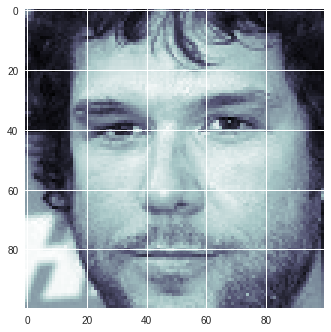

In [0]:
neighbors = NearestNeighbors(n_neighbors=5, algorithm='ball_tree',
metric='euclidean').fit(X_train_pca_lda, y_train)

random_image_index = random.randint(0,39)
distances, indices = neighbors.kneighbors([X_test_all_pca_lda[random_image_index]])

original = np.reshape(X_test_all[random_image_index], (100,100))
plt.imshow(original, cmap=plt.cm.bone, interpolation='nearest')

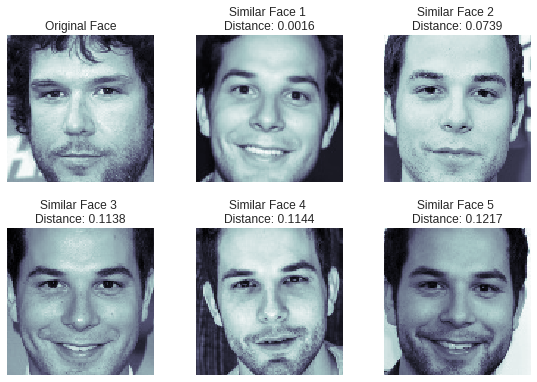

In [0]:
nn1 = np.reshape(X_train[indices[0][0]], (100,100))
nn2 = np.reshape(X_train[indices[0][1]], (100,100))
nn3 = np.reshape(X_train[indices[0][2]], (100,100))
nn4 = np.reshape(X_train[indices[0][3]], (100,100))
nn5 = np.reshape(X_train[indices[0][4]], (100,100))

fig, axes = plt.subplots(nrows=2, ncols=3)
fig.tight_layout() 

plt.subplot(2, 3, 1)
plt.imshow(original,cmap=plt.cm.bone, interpolation='nearest')
plt.title("Original Face", size=12)
plt.xticks(())
plt.yticks(())
plt.subplot(2, 3, 2)
plt.imshow(nn1,cmap=plt.cm.bone, interpolation='nearest')
plt.title("Similar Face 1 \n"+"Distance: "+str(round(distances[0][0], 4)), size=12)
plt.xticks(())
plt.yticks(())
plt.subplot(2, 3, 3)
plt.imshow(nn2,cmap=plt.cm.bone, interpolation='nearest')
plt.title("Similar Face 2 \n"+"Distance: "+str(round(distances[0][1], 4)), size=12)
plt.xticks(())
plt.yticks(())
plt.subplot(2, 3, 4)
plt.imshow(nn3,cmap=plt.cm.bone, interpolation='nearest')
plt.title("Similar Face 3 \n"+"Distance: "+str(round(distances[0][2], 4)), size=12)
plt.xticks(())
plt.yticks(())
plt.subplot(2, 3, 5)
plt.imshow(nn4,cmap=plt.cm.bone, interpolation='nearest')
plt.title("Similar Face 4 \n"+"Distance: "+str(round(distances[0][3], 4)), size=12)
plt.xticks(())
plt.yticks(())
plt.subplot(2, 3, 6)
plt.imshow(nn5,cmap=plt.cm.bone, interpolation='nearest')
plt.title("Similar Face 5 \n"+"Distance: "+str(round(distances[0][4], 4)), size=12)
plt.xticks(())
plt.yticks(())

plt.show()

###5.2.3 Transfer learning

Create a KNN model fitted to the activations of the VGG Face Descriptor (with k = 5)

In [0]:
# the pretrained network's activations for person A and B
activations_a = activations[0:30]
activations_b = activations[30:60]

Get the 5 nearest neighbours for a given activaiton, based on activations of A and B

In [0]:
knn = NearestNeighbors(n_neighbors=5, metric="cosine")
knn.fit(activations_a + activations_b)

NearestNeighbors(algorithm='auto', leaf_size=30, metric='cosine',
                 metric_params=None, n_jobs=None, n_neighbors=5, p=2,
                 radius=1.0)

Helper function to get the array indices in `activations` of activations similar to the input

In [0]:
def get_indices_of_similar(activation):
  neigh_dist, neigh_ind = knn.kneighbors([ activation ])
  neigh_dist, neigh_ind = neigh_dist[0], neigh_ind[0]
  return neigh_ind

Given a filename, find 5 similar filenames based on face content

In [0]:
def get_similar_files(filename):
  file_activations = filename_to_activation(filename)
  indices = get_indices_of_similar(file_activations)
  knn_predictions = [ face_filenames[i] for i in indices ]
  return knn_predictions

Get a random sample from person C

In [0]:
person_c_file = face_filenames[random.randint(60,69)]
# this should return files like Astin_Face_*.jpg
get_similar_files(person_c_file)

['/content/data/FaceData/ProcessedData/Color/Astin_Face_24.jpg',
 '/content/data/FaceData/ProcessedData/Color/Astin_Face_17.jpg',
 '/content/data/FaceData/ProcessedData/Color/Astin_Face_6.jpg',
 '/content/data/FaceData/ProcessedData/Color/Astin_Face_26.jpg',
 '/content/data/FaceData/ProcessedData/Color/Astin_Face_14.jpg']

Get a random sample from person D

In [0]:
person_d_file = face_filenames[random.randint(70,79)]
# this should return files like Cate_Face_*.jpg
get_similar_files(person_d_file)

['/content/data/FaceData/ProcessedData/Color/Cate_Face_6.jpg',
 '/content/data/FaceData/ProcessedData/Color/Cate_Face_20.jpg',
 '/content/data/FaceData/ProcessedData/Color/Cate_Face_9.jpg',
 '/content/data/FaceData/ProcessedData/Color/Cate_Face_12.jpg',
 '/content/data/FaceData/ProcessedData/Color/Cate_Face_8.jpg']

Download an unseen picture of Tilda from the internet

In [0]:
url = "https://in.bmscdn.com/iedb/artist/images/website/poster/large/tilda-swinton-2367-03-04-2017-17-09-56.jpg"
download(url, "/content/sample_data/tilda_test.png")
# should return files like Cate_Face_*.jpg
get_similar_files("/content/sample_data/tilda_test.png")

['/content/data/FaceData/ProcessedData/Color/Cate_Face_6.jpg',
 '/content/data/FaceData/ProcessedData/Color/Cate_Face_20.jpg',
 '/content/data/FaceData/ProcessedData/Color/Cate_Face_9.jpg',
 '/content/data/FaceData/ProcessedData/Color/Cate_Face_12.jpg',
 '/content/data/FaceData/ProcessedData/Color/Cate_Face_8.jpg']

Show a gallery of all of person C & D's faces and their identification predictions

In [0]:
identifications = [ get_similar_files(filename)[0] for filename in face_filenames[60:80] ]
identifications = [ np.asarray(Image.open(filename)) for filename in identifications ]

In [0]:
from PIL import Image
images_tf_id = [cv2.cvtColor(cv2.imread(filename), cv2.COLOR_BGR2RGB) for filename in face_filenames[60:80] ]

In [0]:
def plot_double_gallery(images1, images2, titles, h, w, n_row=5, n_col=4):
    """Helper function to plot a gallery of portraits"""
    plt.figure(figsize=(1.8 * n_col * 2, 2.4 * n_row * 2))
    #plt.subplots_adjust(bottom=0, left=.01, right=.99, top=.90, hspace=.35)
    for i in range(0, n_row * n_col, 2):
        # show input image
        plt.subplot(n_row, n_col, i + 1)
        plt.imshow(images1[i].reshape((h, w, 3)), cmap=plt.cm.gray)
        plt.title("Original: " + titles[i], size=12)
        plt.xticks(())
        plt.yticks(())

        # show nearset in training set
        plt.subplot(n_row, n_col, i + 2)
        plt.imshow(images2[i].reshape((h, w, 3)), cmap=plt.cm.gray)
        plt.title("Most similar face to the left", size=12)
        plt.xticks(())
        plt.yticks(())

In [0]:
# take the last 16 chars from the filename
titles = [ "..." + name[-16:] for name in face_filenames[60:80] ]

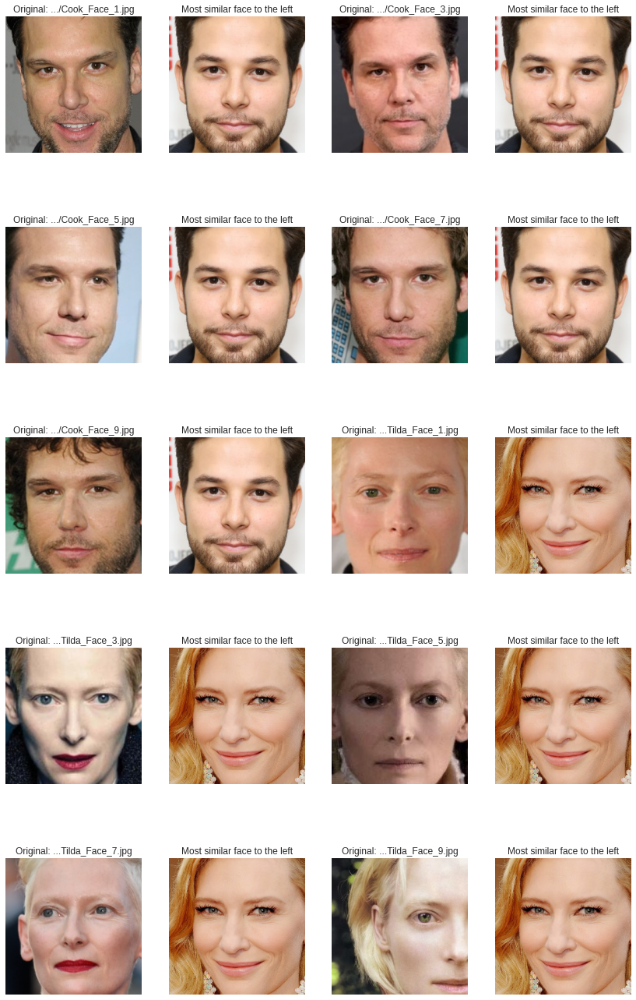

In [0]:
plot_double_gallery(images_tf_id, identifications, titles, 244, 244)

###5.2.4 Discussion

####HOG:
For identification with HOG, k nearest neighbours algorithm was used to find k most similar faces from the training set to the test image provided. A similarity metrics of Eculidean Distance was calculated between all the pairs of data. The identification was pretty accurate when k is small but for larger k such as 8, it returns false positives.

####PCA:

* Our identification step randomly pick a face from our 40 testing images, feed it into the k-nearest neighbours classifier and output the 5 most similar faces. 
* The similarity (distance) calculation can be done in different ways. In this case, we used euclidean distance, and showed results in different nearest neighbours algorithms: brute forced, kd-tree and ball tree.

####Transfer learning:
It appears that the pretrained neural network always picks the same picture for a lookalike; this makes sense at that's probably the picture where the two look most similar. 

##5.3 Impress your TA’s

---



### 5.3.1 Improving Classification Accuracy for HOG and SVM

As it was observed in section 5.1.1, the model incorrectly predicted the image below of Person D (1) as Person A (0). Therefore, in this section, we modify the classification algorithm by using the concept of sliding windows.

(2808,)


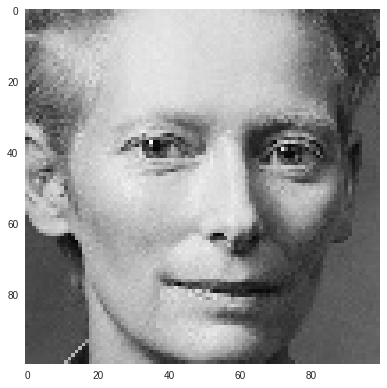

In [0]:
plt.rcParams["axes.grid"] = False
test_image = cv2.cvtColor(faces[77], cv2.COLOR_RGB2GRAY)   
imshow(test_image)
print(training_data[0].shape)

Using the sliding window, the input image is traversed across multiple sub sections and the HOG feature vector of each sub section is computed. Then, the SVM model is used to predict the result for each HOG feature vector extracted from the sliding window. The optimal parameters derived in section 4.1 were used to calculate HOG features.

In [0]:
threshold = .3

# define the sliding window:
def sliding_window(image, stepSize, windowSize):# image is the input, step size is the no.of pixels needed to skip and windowSize is the size of the actual window
    # slide a window across the image
    for y in range(0, image.shape[0], stepSize):# this line and the line below actually defines the sliding part and loops over the x and y coordinates
        for x in range(0, image.shape[1], stepSize):
            # yield the current window
            yield (x, y, image[y: y + windowSize[1], x:x + windowSize[0]])

# read the image you want to detect the object in:
img= test_image

# defining the size of the sliding window (has to be, same as the size of the image in the training data)
(winW, winH)= (200,100)
windowSize=(winW,winH)
downscale=1.5
params = {'orientations': 9, 'pixels_per_cell': (14, 14), 'cells_per_block': (2, 2), 'transform_sqrt':True, 'block_norm':'L2-Hys'}
orientations = params['orientations']
pixels_per_cell = params['pixels_per_cell']
cells_per_block = params['cells_per_block']
transform_sqrt = params['transform_sqrt']
block_norm = params['block_norm']

def predict_using_sliding_window(img):
  # Try it with image resized if the image is too big
  img= cv2.resize(img,(300,200)) # can change the size to default by commenting this code out our put in a random number
  orig = img.copy()

  # Test the trained classifier on an image below!
  scale = 0
  detections = []
  slides = []
  slide_hogs = []
  # Apply sliding window:
  for resized in pyramid_gaussian(img, downscale=1.5): # loop over each layer of the image that you take!
      # loop over the sliding window for each layer of the pyramid
      for (x,y,window) in sliding_window(resized, stepSize=10, windowSize=(winW,winH)):
          # if the window does not meet our desired window size, ignore it!
          if window.shape[0] != winH or window.shape[1] !=winW: # ensure the sliding window has met the minimum size requirement
              continue
        
          slides.append(window)
          #creating hog features 
          fds, hog_image = hog(window, orientations=orientations, pixels_per_cell=pixels_per_cell, cells_per_block=cells_per_block, block_norm=block_norm, feature_vector=True, visualize=True, transform_sqrt=transform_sqrt)# fd= feature descriptor
          fds = fds.reshape(1, -1) # re shape the image to make a silouhette of hog
          pred = model_svm.predict(fds) # use the SVM model to make a prediction on the HOG features extracted from the window
          slide_hogs.append(hog_image)
          if pred == 1:
              if model_svm.decision_function(fds) > 0.6:  # set a threshold value for the SVM prediction i.e. only firm the predictions above probability of 0.6
                  print("Detection:: Location -> ({}, {})".format(x, y))
                  print("Scale ->  {} | Confidence Score {} \n".format(scale,model_svm.decision_function(fds)))
                  detections.append((int(x * (downscale**scale)), int(y * (downscale**scale)), model_svm.decision_function(fds),
                                    int(windowSize[0]*(downscale**scale)), # create a list of all the predictions found
                                        int(windowSize[1]*(downscale**scale))))
      scale+=1
      
  clone = resized.copy()
  for (x_tl, y_tl, _, w, h) in detections:
      cv2.rectangle(img, (x_tl, y_tl), (x_tl + w, y_tl + h), (0, 0, 255), thickness = 2)
  rects = np.array([[x, y, x + w, y + h] for (x, y, _, w, h) in detections]) # do nms on the detected bounding boxes
  sc = [score[0] for (x, y, score, w, h) in detections]
  print("detection confidence score: ", sc)
  sc = np.array(sc)
  pick = non_max_suppression(rects, probs = sc, overlapThresh = 0.3)

 # this creates a raw bounding box before using NMS
  nms_score = []
  for (xA, yA, xB, yB) in (pick):
    for i, [xA2, yA2, xB2, yB2] in enumerate(rects):
      if ([xA, yA, xB, yB] ==  [xA2, yA2, xB2, yB2]):
        nms_score.append(sc[i])
 
  # this creates a bounding box after using nms on the detections.
  font = cv2.FONT_HERSHEY_SIMPLEX   # font 
  fontScale = 0.45   # fontScale 
  color = (255, 0, 0)  # Blue color in BGR 
  thickness = 1 # Line thickness of 1 px 
  print("Raw Detections after NMS")
  i = 0
  for (xA, yA, xB, yB) in pick:
      prob_score = "Cate {}".format(round(nms_score[i],2))
      orig = cv2.putText(orig, prob_score, (xA+5,yA-5), font, fontScale, color, thickness, cv2.LINE_AA) 
      cv2.rectangle(orig, (xA, yA), (xB, yB), (0,255,0), 2)
      i +=1

  imshow(orig)
  return orig, slides, slide_hogs

By using the above algorithm, we are able to get correct predictions on the image data which was previously being misclassified.

Detection:: Location -> (80, 0)
Scale ->  0 | Confidence Score [0.61004363] 

Detection:: Location -> (70, 20)
Scale ->  0 | Confidence Score [0.68056585] 

Detection:: Location -> (80, 20)
Scale ->  0 | Confidence Score [0.62266044] 

Detection:: Location -> (90, 20)
Scale ->  0 | Confidence Score [0.75026184] 

Detection:: Location -> (70, 30)
Scale ->  0 | Confidence Score [0.75691569] 

Detection:: Location -> (80, 30)
Scale ->  0 | Confidence Score [0.74969623] 

Detection:: Location -> (90, 30)
Scale ->  0 | Confidence Score [0.75399456] 

Detection:: Location -> (80, 40)
Scale ->  0 | Confidence Score [0.63198205] 

Detection:: Location -> (90, 40)
Scale ->  0 | Confidence Score [0.71249499] 

Detection:: Location -> (70, 90)
Scale ->  0 | Confidence Score [0.61764851] 

Detection:: Location -> (80, 100)
Scale ->  0 | Confidence Score [0.61266756] 

Detection:: Location -> (0, 20)
Scale ->  1 | Confidence Score [0.66778275] 

detection confidence score:  [0.6100436257165937, 0.6

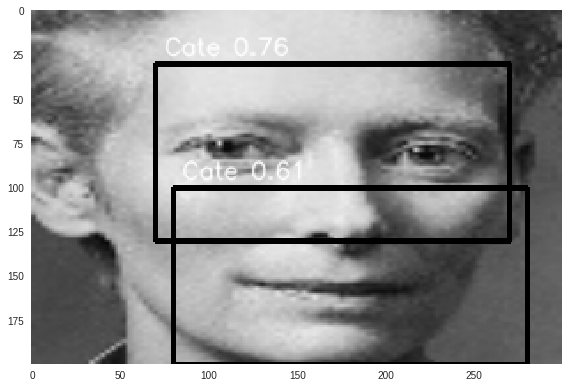

In [0]:
_, slides, slide_hogs = predict_using_sliding_window(img)

125


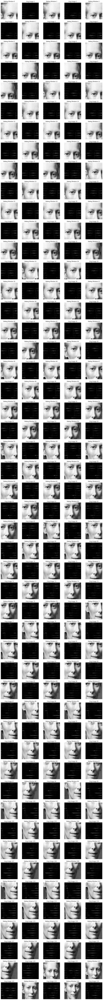

In [0]:
# Helper method to plot the sliding windows and its corresponding HOG images
def plot_sliding_windows(slides, slide_hogs):
  n_row=50
  n_col=5
  j = 0
  h = 100
  w = 100
  print(len(slides))
  plt.figure(figsize=(1.5 * n_col * 2, 1.5 * n_row * 2))
  for i in range(0, n_row * n_col, 2):
      if (j < len(slides)):
        # show input image
        plt.subplot(n_row, n_col, i + 1)
        plt.imshow(cv2.resize(slides[j], (h, w)), cmap=plt.cm.gray)
        plt.title("Sliding Window {}".format(j), size=12)
        plt.xticks(())
        plt.yticks(())

        # show corresponding hog image
        plt.subplot(n_row, n_col, i + 2)
        plt.imshow(cv2.resize(slide_hogs[j], (h, w)), cmap=plt.cm.gray)
        plt.title("Hog Image {}".format(j), size=12)
        plt.xticks(())
        plt.yticks(())
        j+=1

plot_sliding_windows(slides, slide_hogs)

To further check the accuracy of the classifier, we use some additional skewed images of Tilda Swinton (Person D) which should be classified as Cate Blanchett (Person B).

In [0]:
#Downloading additional images of Tilda Swinton (Person D)
tilda_new_face_dataset_url = "https://drive.google.com/uc?export=download&id=1oorsdCLKFzY-STIFuSIDz_ZfsF5N-3bM"
dir = "/content/sample_data/CV__Group_assignment/Tilda_new_faces.zip"
download(tilda_new_face_dataset_url,dir)
print("All the files are downloaded")

with ZipFile(dir) as zipf:
  zipf.extractall("/content/data/FaceData/Tilda_new_faces")


All the files are downloaded


In [0]:
# Set our working path again
new_base_path = "/content/data/FaceData/Tilda_new_faces/"
if not os.path.isdir(new_base_path):
  os.makedirs(new_base_path)

In [0]:
# Predict new images
new_image_list = ['Tilda_new_'+str(i+1)+'.jpg' for i in range(13)]
new_images = []
predicted_imgs = []
for i, item in enumerate(new_image_list):
    image = cv2.imread(new_base_path+item)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB) #By default imread reads the images in BGR space, so convert it into RGB
    image = cv2.resize(image,(500,500)) #Resize the images in order to plot it well. This will cause some images to be stretched
    new_images.append(image)
    orig, slides, slide_hogs = predict_using_sliding_window(image)
    predicted_imgs.append(orig)

Detection:: Location -> (10, 0)
Scale ->  0 | Confidence Score [0.6542511] 

Detection:: Location -> (0, 10)
Scale ->  0 | Confidence Score [0.64792001] 

Detection:: Location -> (10, 10)
Scale ->  0 | Confidence Score [0.77658325] 

Detection:: Location -> (20, 10)
Scale ->  0 | Confidence Score [0.71085368] 

Detection:: Location -> (0, 20)
Scale ->  0 | Confidence Score [0.60529718] 

Detection:: Location -> (10, 20)
Scale ->  0 | Confidence Score [0.72212248] 

Detection:: Location -> (0, 30)
Scale ->  0 | Confidence Score [0.83593196] 

Detection:: Location -> (10, 30)
Scale ->  0 | Confidence Score [0.76540841] 

Detection:: Location -> (20, 30)
Scale ->  0 | Confidence Score [0.72064879] 

Detection:: Location -> (0, 40)
Scale ->  0 | Confidence Score [0.90212647] 

Detection:: Location -> (10, 40)
Scale ->  0 | Confidence Score [0.68855433] 

Detection:: Location -> (0, 50)
Scale ->  0 | Confidence Score [0.62607076] 

Detection:: Location -> (80, 80)
Scale ->  0 | Confidence S

The predicted images are shown below. Images 2, 4 and 5 don't give any predictions since there is a lot of unnecessary background information also present. However, when we crop the picture 2 and 4 and extract faces from them, we are able to get correct predictions on those images as well (as can be seen from images 12 and 13). The classifier is shown here to be robust to any obstructions, rotations, blurring or illumination. It is also shown to give correct predictions when 2 different people are together in 1 image.

In [0]:
n_row=8
n_col=6
j = 0
h = 500
w = 500
plt.figure(figsize=(2.5 * n_col * 2, 2.5 * n_row * 2))
for i in range(0, n_row * n_col, 2):
    # show input image
    if j < len(predicted_imgs):
      plt.subplot(n_row, n_col, i + 1)
      plt.imshow(cv2.resize(predicted_imgs[j], (h, w)), cmap=plt.cm.gray)
      plt.title("Mutated Tilda Image {}".format(j+1), size=12)
      plt.xticks(())
      plt.yticks(())
      j+=1

What breaks the HOG + SVM Classifier

In [0]:
img = cv2.cvtColor(new_images[4], cv2.COLOR_RGB2GRAY)   
orig, slides, slide_hogs = predict_using_sliding_window(img)

As it can be observed, the above image breaks the classifier as it has two images superimposed over one another. There are three eyes as compared to two and other facial features also seem distorted. This is the reason why the HOG features are not matched with the training images in any of the sliding windows. Hence, resulting in no classifications.

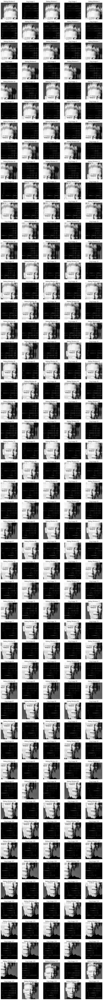

125


In [0]:
plot_sliding_windows(slides, slide_hogs)

###5.3.2 Case May Break PCA k-NN Classifier

Back to 5.1.2 PCA classification section, we have already made improvements by using LDA to reduce the dimension again and it worked well on Random Forest and Multilayer Perceptron classifier by significantly increased their accuracy.

Now we will try to figure out that under what situation - what kind of face image may break our k-NN classifier. In this section, we are going to test our identification system in 5.2.2 which results were more directly visualised.

Here we pick one typical image from Cat's testing images. In this picture, she does not have her 'normal' look, with a bang and not very sharp face bone structure. We guess this may interfere our classifier.

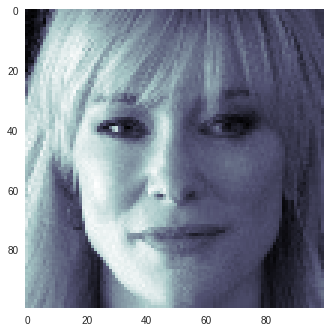

In [0]:
neighbors = NearestNeighbors(n_neighbors=5, algorithm='ball_tree',
metric='euclidean').fit(X_train_pca_lda, y_train)

distances, indices = neighbors.kneighbors([X_test_all_pca_lda[12]])

original = np.reshape(X_test_all[12], (100,100))
plt.imshow(original, cmap=plt.cm.bone, interpolation='nearest')

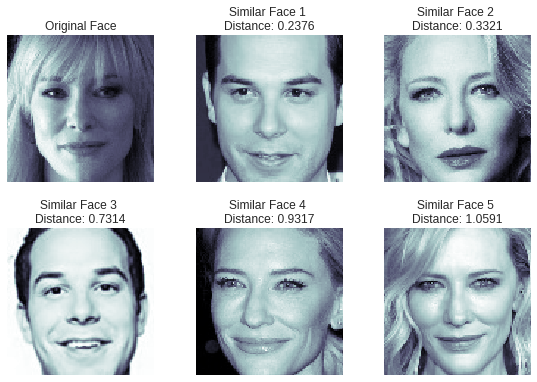

In [0]:
nn1 = np.reshape(X_train[indices[0][0]], (100,100))
nn2 = np.reshape(X_train[indices[0][1]], (100,100))
nn3 = np.reshape(X_train[indices[0][2]], (100,100))
nn4 = np.reshape(X_train[indices[0][3]], (100,100))
nn5 = np.reshape(X_train[indices[0][4]], (100,100))

fig, axes = plt.subplots(nrows=2, ncols=3)
fig.tight_layout() 

plt.subplot(2, 3, 1)
plt.imshow(original,cmap=plt.cm.bone, interpolation='nearest')
plt.title("Original Face", size=12)
plt.xticks(())
plt.yticks(())
plt.subplot(2, 3, 2)
plt.imshow(nn1,cmap=plt.cm.bone, interpolation='nearest')
plt.title("Similar Face 1 \n"+"Distance: "+str(round(distances[0][0], 4)), size=12)
plt.xticks(())
plt.yticks(())
plt.subplot(2, 3, 3)
plt.imshow(nn2,cmap=plt.cm.bone, interpolation='nearest')
plt.title("Similar Face 2 \n"+"Distance: "+str(round(distances[0][1], 4)), size=12)
plt.xticks(())
plt.yticks(())
plt.subplot(2, 3, 4)
plt.imshow(nn3,cmap=plt.cm.bone, interpolation='nearest')
plt.title("Similar Face 3 \n"+"Distance: "+str(round(distances[0][2], 4)), size=12)
plt.xticks(())
plt.yticks(())
plt.subplot(2, 3, 5)
plt.imshow(nn4,cmap=plt.cm.bone, interpolation='nearest')
plt.title("Similar Face 4 \n"+"Distance: "+str(round(distances[0][3], 4)), size=12)
plt.xticks(())
plt.yticks(())
plt.subplot(2, 3, 6)
plt.imshow(nn5,cmap=plt.cm.bone, interpolation='nearest')
plt.title("Similar Face 5 \n"+"Distance: "+str(round(distances[0][4], 4)), size=12)
plt.xticks(())
plt.yticks(())

plt.show()

Indeed! From the result above, we noticed that there are two faces of Skylar got identified as similar faces and even achieved very high similarity scores. 

Like we mentioned above, this picture was seletcted intentionally, to test the classifier. While constructing eigenfaces, bone structures and lightning are very crucial. In this specific image, the brightness are much lower also with much less obvious bone structures. These could all influence the classification result.

##6. Discussion

###6.1 HOG
Traditional machine learning techniques were used for object detection and compared with the new ones. Here the traditional Histogram Oriented Gradient approach and the modern techniques such as PCA and transfer learning were used and compared. The object detected was a face of a celebrity and then classification and identification was performed on the celebrities and their look alikes. HOG was used to extract features from images of faces of the celebrities but the classification was not coming out as accurate. However, when we use pyramidal scheme in section 5.3.1 for face detection (using the concept of sliding windows), the classification improved significantly. The reason for this is that for smaller scales, the HOG extraction provides more fine grained features while for larger scales, they provide more global information.

If we were to sell the HOG classification algorithm for authentication of employees through face detection, this algorithm would work fairly well. However, the system can also be fooled easily by camouflage techniques. In that case, it would be advisable to extract every facial feature separately e.g., retina scan, smile, etc., along with complete facial features and then train the classifier on all types of data and average the score to get a final accuracy.

###6.2 PCA

* By using PCA, we successfully reduced our working image dimensions and managed to use this feature representation space to get good classification and identification accuracy.

* PCA’s key advantages are its low noise sensitivity, the
decreased requirements for capacity and memory, and
increased efficiency given the processes taking place in a
smaller dimensions. [1]

* PCA also rely on the clear bone structure and appropriate lightning a lot, which means if a face image is too bright, dark or blurred, PCA may not be able to pick up the right features for classification.

###6.3 Transfer learning
For transfer learning, it is important to remember that real life results may not be as good as those shown here, especially as the VGG Face Descriptor was pretrained with some of the celebreties we used to demonstrate the algorithm.

##7. References

[1] Wikipedia contributors. (2020, April 11). Principal component analysis. In Wikipedia, The Free Encyclopedia. Retrieved 14:45, April 12, 2020, from https://en.wikipedia.org/w/index.php?title=Principal_component_analysis&oldid=950368437

[2] Wikipedia contributors. (2020, April 7). Linear discriminant analysis. In Wikipedia, The Free Encyclopedia. Retrieved 14:46, April 12, 2020, from https://en.wikipedia.org/w/index.php?title=Linear_discriminant_analysis&oldid=949638160

[3] SANDIPAN DEY. (2018, JANUARY 6). EigenFaces and A Simple Face Detector with PCA/SVD in Python. https://sandipanweb.wordpress.com/2018/01/06/eigenfaces-and-a-simple-face-detector-with-pca-svd-in-python/

[4] Anmol Singh Sethi. (2019, Apr 7). Building Face Detector Using Principal Component Analysis (PCA) From Scratch in Python. https://medium.com/@reubenrochesingh/building-face-detector-using-principal-component-analysis-pca-from-scratch-in-python-1e57369b8fc5





[5] Shankar Muthuswamy. (2014, November 12). Facial Image Compression and Reconstruction with PCA. https://shankarmsy.github.io/posts/pca-sklearn.html#sthash.eb9cqOB1.dpuf

[6] A. Consulting, "Histogram of Oriented Gradients | Learn OpenCV", Learnopencv.com, 2020. [Online]. Available: https://www.learnopencv.com/histogram-of-oriented-gradients/. [Accessed: 14- Apr- 2020]

[7] L. Weng, "Object Detection for Dummies Part 1: Gradient Vector, HOG, and SS", Lil'Log, 2020. [Online]. Available: https://lilianweng.github.io/lil-log/2017/10/29/object-recognition-for-dummies-part-1.html. [Accessed: 14- Apr- 2020]

[8] M. Cheon, W. Lee, C. Hyun and M. Park, "Rotation Invariant Histogram of Oriented Gradients", International Journal of Fuzzy Logic and Intelligent Systems, vol. 11, no. 4, pp. 293-298, 2011.

[9] B. Alsahwa, F. Maussang, R. Garello and A. Chevallier, "Marine life airborne observation using HOG and SVM classifier," OCEANS 2016 MTS/IEEE Monterey, Monterey, CA, 2016, pp. 1-5.